# 增强ALPHA
### 载入必要库
## 构建数据Pipeline
在线平台性能上很难满足大规模调试策略，加上机器学习或深度学习等计算密集型模型，所以本地回测如何提高效率是第一待解决的问题。
而zipline中的pipeline机制是很高效的。
### Bundle的注册
因为此项目我们用Zipline来处理数据，1.2章节中我们创建了数据Bundle。
此处我们需要注册创建的Bundle方便Zipline调用数据。
### 创建Pipeline引擎
我们将运用Pipeline包来处理股票数据。此前，我们需要创建Pipeline引擎，方便之后使用。
#### 查看数据
创建Pipeline引擎后，查看股票池最后一天的股票列表。

In [1]:
import sys
import project_helper
import project_tests

import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt

%matplotlib inline
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (14, 8)

import sys
import os
from zipline.data import bundles

os.environ['ZIPLINE_ROOT'] = os.path.join('C:/Users/ltjsu/.zipline')

ingest_func = bundles.csvdir.csvdir_equities(['daily'], 'custom-csvdir-bundle')
bundles.register('custom-csvdir-bundle', ingest_func)

from zipline.pipeline import Pipeline
from zipline.pipeline.factors import AverageDollarVolume
from zipline.utils.calendars import get_calendar

# universe = AverageDollarVolume(window_length=120).top(500) 
trading_calendar = get_calendar('XSHG')
bundle_data = bundles.load('custom-csvdir-bundle')
engine = project_helper.build_pipeline_engine(bundle_data, trading_calendar)

C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\statsmodels\compat\pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


简单处理股票列表信息，方便获取申万行业数据。
### 获取收益率
构建DataPortal获取个股收益率数据。

自定义函数`get_pricing`获取股票收益率，增加代码可读性。

In [2]:
from zipline.data.data_portal import DataPortal
data_portal = DataPortal(
    bundle_data.asset_finder,
    trading_calendar=trading_calendar,
    first_trading_day=bundle_data.equity_daily_bar_reader.first_trading_day,
    equity_minute_reader=None,
    equity_daily_reader=bundle_data.equity_daily_bar_reader,
    adjustment_reader=bundle_data.adjustment_reader)

def get_pricing(data_portal, trading_calendar, assets, start_date, end_date, field='close'):
    end_dt = pd.Timestamp(end_date.strftime('%Y-%m-%d'), tz='UTC', offset='C')
    start_dt = pd.Timestamp(start_date.strftime('%Y-%m-%d'), tz='UTC', offset='C')

    end_loc = trading_calendar.closes.index.get_loc(end_dt)
    start_loc = trading_calendar.closes.index.get_loc(start_dt)

    return data_portal.get_history_window(
        assets=assets,
        end_dt=end_dt,
        bar_count=end_loc - start_loc,
        frequency='1d',
        field=field,
        data_frequency='daily')

# Alpha因子
定义Alpha因子。此项目主要关注以下因子：
- 动量因子_1年
- 行业中性均值回归_5日平滑因子
- 隔夜情绪平滑因子

**此处务必保证，factor_start_date不能是周末和节假日，不然后面会报错**

### 往Pipeline中添加因子
将以上因子添加到Pipeline中。

## 特征工程
定义一些对模型预测有帮助的特征。 好的基础特征能够作为显著的条件因子，对模型最终的预测有帮助。
### 一些”通用“量化特征
为了体现通用性，我们运用一下基础特征：
- 股票波动 20日平滑, 120日平滑
- 成交量量 20日平滑, 120日平滑
- 行业

### 市场特征
Regime Features
为了抓取市场特性，我们运用一下特征：
- 市场波动 20日平滑, 120日平滑
- 市场分散（离差） 20日平滑, 120日平滑

### 标签--预测目标
此项目对未来一周的收益做预测。因此量化目标过程中，因子追踪五日收益率。

### 日期特征
因为日历异象（calendar anomalies）的存在，此处定义一些日期相关的特征。

In [3]:
from zipline.pipeline.factors import CustomFactor, DailyReturns, Returns, SimpleMovingAverage, AnnualizedVolatility
from zipline.pipeline.data import USEquityPricing

universe_end_date = pd.Timestamp('2020-10-27', tz='UTC')
# 2020-09-28； 2020-08-28； 2020-07-28；2020-06-27；2020-05-28 
factor_start_date = universe_end_date - pd.DateOffset(years=5, days=4)
print(factor_start_date)
universe = AverageDollarVolume(window_length=120).top(500)
sector = project_helper.Sector()

def momentum_1yr(window_length, universe, sector):
    return Returns(window_length=window_length, mask=universe) \
        .demean(groupby=sector) \
        .rank() \
        .zscore()

def mean_reversion_5day_sector_neutral_smoothed(window_length, universe, sector):
    unsmoothed_factor = -Returns(window_length=window_length, mask=universe) \
        .demean(groupby=sector) \
        .rank() \
        .zscore()
    return SimpleMovingAverage(inputs=[unsmoothed_factor], window_length=window_length) \
        .rank() \
        .zscore()

class CTO(Returns):
    """
    Computes the overnight return, per hypothesis from
    https://papers.ssrn.com/sol3/papers.cfm?abstract_id=2554010
    """
    inputs = [USEquityPricing.open, USEquityPricing.close]
    
    def compute(self, today, assets, out, opens, closes):
        """
        The opens and closes matrix is 2 rows x N assets, with the most recent at the bottom.
        As such, opens[-1] is the most recent open, and closes[0] is the earlier close
        """
        out[:] = (opens[-1] - closes[0]) / closes[0]
        
class TrailingOvernightReturns(Returns):
    """
    Sum of trailing 1m O/N returns
    """
    window_safe = True
    
    def compute(self, today, asset_ids, out, cto):
        out[:] = np.nansum(cto, axis=0)

def overnight_sentiment_smoothed(cto_window_length, trail_overnight_returns_window_length, universe):
    cto_out = CTO(mask=universe, window_length=cto_window_length)
    unsmoothed_factor = TrailingOvernightReturns(inputs=[cto_out], window_length=trail_overnight_returns_window_length) \
        .rank() \
        .zscore()
    return SimpleMovingAverage(inputs=[unsmoothed_factor], window_length=trail_overnight_returns_window_length) \
        .rank() \
        .zscore()
        
class MarketDispersion(CustomFactor):
    inputs = [DailyReturns()]
    window_length = 1
    window_safe = True

    def compute(self, today, assets, out, returns):
        # returns are days in rows, assets across columns
        out[:] = np.sqrt(np.nanmean((returns - np.nanmean(returns))**2))
        
class MarketVolatility(CustomFactor):
    inputs = [DailyReturns()]
    window_length = 1
    window_safe = True
    
    def compute(self, today, assets, out, returns):
        mkt_returns = np.nanmean(returns, axis=1)
        out[:] = np.sqrt(260.* np.nanmean((mkt_returns-np.nanmean(mkt_returns))**2))
        

pipeline = Pipeline(screen=universe)
pipeline.add(momentum_1yr(252, universe, sector),'Momentum_1YR')
pipeline.add(mean_reversion_5day_sector_neutral_smoothed(20, universe, sector),'Mean_Reversion_Sector_Neutral_Smoothed')
pipeline.add(overnight_sentiment_smoothed(2, 10, universe),'Overnight_Sentiment_Smoothed')
pipeline.add(AnnualizedVolatility(window_length=20, mask=universe).rank().zscore(), 'volatility_20d')
pipeline.add(AnnualizedVolatility(window_length=120, mask=universe).rank().zscore(), 'volatility_120d')
pipeline.add(AverageDollarVolume(window_length=20, mask=universe).rank().zscore(), 'adv_20d')
pipeline.add(AverageDollarVolume(window_length=120, mask=universe).rank().zscore(), 'adv_120d')
pipeline.add(sector, 'sector_code')
pipeline.add(SimpleMovingAverage(inputs=[MarketDispersion(mask=universe)], window_length=20), 'dispersion_20d')
pipeline.add(SimpleMovingAverage(inputs=[MarketDispersion(mask=universe)], window_length=120), 'dispersion_120d')
pipeline.add(MarketVolatility(window_length=20), 'market_vol_20d')
pipeline.add(MarketVolatility(window_length=120), 'market_vol_120d')
pipeline.add(Returns(window_length=5, mask=universe).quantiles(2), 'return_5d')
# pipeline.add(Returns(window_length=5, mask=universe).quantiles(25), 'return_5d_p')
# pipeline.add(Returns(window_length=10, mask=universe).quantiles(2), 'return_10d')
# pipeline.add(Returns(window_length=10, mask=universe).quantiles(25), 'return_10d_p')

all_factors = engine.run_pipeline(pipeline, factor_start_date, universe_end_date)
all_factors['is_Janaury'] = all_factors.index.get_level_values(0).month == 1
all_factors['is_December'] = all_factors.index.get_level_values(0).month == 12
all_factors['weekday'] = all_factors.index.get_level_values(0).weekday
all_factors['quarter'] = all_factors.index.get_level_values(0).quarter
all_factors['qtr_yr'] = all_factors.quarter.astype('str') + '_' + all_factors.index.get_level_values(0).year.astype('str')
all_factors['month_end'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BM'))
all_factors['month_start'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BMS'))
all_factors['qtr_end'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BQ'))
all_factors['qtr_start'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BQS'))

2015-10-23 00:00:00+00:00


去处5_10日回报中的异常数据。
### 行业信息独热编码
独热编码有助于模型更好的理解行业信息。

### 日期平移
每日收益率往前平移5/10日（一/两周），作为模型目标。
### 目标独立相似分布（IID）检测
查看平移不同时长的收益率之间是否是独立同分布。
**斯皮尔曼相关度计算**

In [4]:
from scipy.stats import spearmanr

def sp(group, col1_name, col2_name):
    x = group[col1_name]
    y = group[col2_name]
    return spearmanr(x, y)[0]

all_factors['return_5d'].replace(to_replace=-1, value=np.nan, inplace=True)
# all_factors['return_10d'].replace(to_replace=-1, value=np.nan, inplace=True)

sector_lookup = pd.read_csv(
    os.path.join(os.getcwd(), 'data', 'project_7_sector', 'labels.csv'),
    index_col='Sector_i')['Sector'].to_dict()
sector_lookup

sector_columns = []
for sector_i, sector_name in sector_lookup.items():
    secotr_column = '{}行业'.format(sector_name)
    sector_columns.append(secotr_column)
    all_factors[secotr_column] = (all_factors['sector_code'] == sector_i)

all_factors['target_5D'] = all_factors.groupby(level=1)['return_5d'].shift(-5)
# all_factors['target_10D'] = all_factors.groupby(level=1)['return_10d'].shift(-10)

### 标签平移对于自相关的影响
从上图中可以观察到：

$ 自相关{Target1} > 自相关{Target2} > 自相关{Target3} > 自相关{Target4}$

自相关随着增加两次收益之间的间隔而减小。 自相关在正范围内，这意味着未来收益趋向于与过去收益相同的方向。此外，滞后1的自相关约在0.5附件振荡，滞后4的自相关约在0附近振荡，因此序列相关的程度从中等到非常低

这与股票收益通常表现出序列相关性是一致的

### 拆分训练集/验证集/测试集
将数据分为训练，验证和测试数据集。 实现函数“ train_valid_test_split”将输入样本“ all_x”和目标值“ all_y”分割为训练，验证和测试数据集。 比例大小分别是“ train_size”，“ valid_size”和“ test_size”。

分割时，请确保数据分别来自训练，验证和测试的顺序。 假设“ train_size”为0.7，“ valid_size”为0.2，而“ test_size”为0.1。 all_x和all_y的前70％是训练集合。 接下来的all_x和all_y 20％将是验证集。 all_x和all_y的最后10％是测试集。 确保不要将同一天分配给多个数据集，它应包含在单个数据集中。

得到`train_valid_test_split`之后，就可以将数据拆分成训练集、验证集和测试集。
选取如下特征和5日收益率为预测目标。

In [5]:
def train_valid_test_split(all_x, all_y, train_size, valid_size, test_size):
    """
    Generate the train, validation, and test dataset.
    """
    assert train_size >= 0 and train_size <= 1.0
    assert valid_size >= 0 and valid_size <= 1.0
    assert test_size >= 0 and test_size <= 1.0
    assert train_size + valid_size + test_size == 1.0
    
    # TODO: Implement
    train_inx = int(len(all_x) * train_size)
    valid_ind = int(len(all_x) * (train_size + valid_size))
    x_train = all_x[:train_inx]
    x_valid = all_x[train_inx:valid_ind]
    x_test  = all_x[valid_ind:]
    y_train = all_y[:train_inx]
    y_valid = all_y[train_inx:valid_ind]
    y_test  = all_y[valid_ind:]
    
    return x_train, x_valid, x_test, y_train, y_valid, y_test

project_tests.test_train_valid_test_split(train_valid_test_split)

features = [
    'Mean_Reversion_Sector_Neutral_Smoothed', 'Momentum_1YR',
    'Overnight_Sentiment_Smoothed', 'adv_120d', 'adv_20d',
    'dispersion_120d', 'dispersion_20d', 'market_vol_120d',
    'market_vol_20d', 'volatility_20d',
    'is_Janaury', 'is_December', 'weekday',
    'month_end', 'month_start', 'qtr_end', 'qtr_start'] + sector_columns
# target_label = 'target_10D'
target_label = 'target_5D'

temp = all_factors.dropna().copy()
X = temp[features]
y = temp[target_label].astype(int)

X_train, X_valid, X_test, y_train, y_valid, y_test = train_valid_test_split(X, y, 0.8, 0.1, 0.1)

Tests Passed


In [6]:
y_train.value_counts()

1    195652
0    194216
Name: target_5D, dtype: int64

# 集成学习
## 随即森林
### 决策树
单个决策树决策效果展示。

**对标的日期不做区分，使得此模型对股票种类不敏感，时序信息也丢失较多**

**对单一标定分别进行训练，将学习出属于不同标的的特性。高频数据将解决数据不够的问题**

### 随机森林超参数 -- 决策树数量
定义不同参数，来确定最好的模型。
#### 参数
参见以下参数

##### min_samples_leaf
min_samples_leaf ： 决策树每个叶--也就是决策树最底层样本数量。 足够小，有助于模型抓住数据细节；过于小，模型容易过拟合。
此参数的值以股票池股票数量的倍数为宜。当夏普率大于4的时候，往往是过拟合的征兆，因此建议设置为10倍股票数量。

次倍数可以调节，但过度调试也会在验证集上过拟合，从而降低模型泛化性，样本外数据表现很差。 因此倍数以指数的形式变动（10倍，20倍，100倍，而不是10倍11倍12倍...）。

##### n_trees_l
参考下图，分类器准确率随着决策树数量的变化。

#### 判定过/欠拟合

- 图中验本外数据比验证集准确率高；决策树数量较少时，训练和样本外集准确率随着决策树增加而增加，而验证集下降，决策树数量较多时，准确率不在变化。
- 准确率的差值可以用来判定过/欠拟合（差距较大--过拟合；差距小--欠拟合）

下标展示，各特征的特征重要度在众多决策树上的均值。

In [7]:
from IPython.display import display
from sklearn.tree import DecisionTreeClassifier

# This is to get consistent results between each run.
clf_random_state = 0
MAX_DEPTH = 4
n_days = 10
n_stocks = 500

clf_parameters = {
    'criterion': 'entropy',
    'min_samples_leaf': n_stocks * n_days,
    'oob_score': True,
    'n_jobs': -1,
    'random_state': clf_random_state}
n_trees_l = [10, 20, 50, 100, 250]

from sklearn.ensemble import RandomForestClassifier

上表中有些特征的特征重要度是0，之后的模型训练不在用这些特征。
### 模型结果
一下而外的指标讲用于衡量模型的预测能力。函数 `show_sample_results` 用来计算如下指标：
- 夏普率
- 因子回报率
- 因子自相关系数排序

**此处是用alphalens，评估模型性能，并不考虑交易成本**

#### 预测效果
用一下几个因子与增强因子做个比较：

##### 训练
模型在训练集上训练。

In [8]:
import alphalens as al

all_assets = all_factors.index.levels[1].values.tolist()
all_pricing = get_pricing(
    data_portal,
    trading_calendar,
    all_assets,
    factor_start_date,
    universe_end_date)

def get_IC(factor_data):
    ls_IC = pd.DataFrame()
    
    for factor, factor_data in factor_data.items():
        ls_IC[factor] = al.performance.factor_information_coefficient(factor_data).iloc[:,0]
        print(factor)
        al.tears.create_full_tear_sheet(factor_data)
        
    return ls_IC

def show_sample_results(data, samples, classifier, factors, pricing=all_pricing,max_loss=0.35):
    # Calculate the Alpha Score
    prob_array=[-1,1]
    print(classifier.predict_proba(samples)[0])
    alpha_score = classifier.predict_proba(samples).dot(np.array(prob_array))
    
    # Add Alpha Score to rest of the factors
    alpha_score_label = '增强_ALPHA'
    factors_with_alpha = data.loc[samples.index].copy()
    factors_with_alpha[alpha_score_label] = alpha_score
    
    # Setup data for AlphaLens
    print('Cleaning Data...\n')
    factor_data = project_helper.build_factor_data(factors_with_alpha[factors + [alpha_score_label]], 
                                                   pricing,max_loss=max_loss,periods=(5))
    print('\n-----------------------\n')
    
    # Calculate Factor Returns and Sharpe Ratio
    factor_returns = project_helper.get_factor_returns(factor_data)
    sharpe_ratio = project_helper.sharpe_ratio(factor_returns)
    
    # Show Results
    print('             Sharpe Ratios')
    print(sharpe_ratio.round(2))
    project_helper.plot_factor_returns(factor_returns)
    project_helper.plot_factor_rank_autocorrelation(factor_data)
    
    factor_IC = get_IC(factor_data)
    print(factor_IC.mean())
    return factor_IC
    
factor_names = [
    'Mean_Reversion_Sector_Neutral_Smoothed',
    'Momentum_1YR',
    'Overnight_Sentiment_Smoothed',
    'adv_120d',
    'volatility_20d',
    'adv_20d']

C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\ipykernel_launcher.py:11: FutureWarning: offset is deprecated. Use freq instead
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\ipykernel_launcher.py:12: FutureWarning: offset is deprecated. Use freq instead
  if sys.path[0] == '':


标签是五日回报，相邻的两个标签有4日是重叠的，导致标签之间自相关性较强。
此处消除标签的自相关性，降低过拟合的可能性。

## 样本重叠
通过yi
Let's fix this by removing overlapping samples. We can do a number of things:

- Don't use overlapping samples
- Use BaggingClassifier's `max_samples`
- Build an ensemble of non-overlapping trees

In this project, we'll do all three methods and compare.
### Drop Overlapping Samples
This is the simplest of the three methods. We'll just drop any overlapping samples from the dataset. Implement the `non_overlapping_samples` function to return a new dataset overlapping samples. 

In [9]:
def non_overlapping_samples(x, y, n_skip_samples, start_i=0):
    """
    Get the non overlapping samples.

    """
    assert len(x.shape) == 2
    assert len(y.shape) == 1
    
    # TODO: Implement
    subsampled_idx = x.index.levels[0].tolist()[start_i :: n_skip_samples + 1]
    non_overlapping_x = x.loc[subsampled_idx]
    non_overlapping_y = y.loc[subsampled_idx]
    
    return non_overlapping_x, non_overlapping_y

# project_tests.test_non_overlapping_samples(non_overlapping_samples)

n_days = 10
n_stocks = 500

clf_parameters = {
    'criterion': 'entropy',
    'min_samples_leaf': n_stocks * n_days,
    'oob_score': True,
    'n_jobs': -1,
    'random_state': clf_random_state}
n_trees_l = [10, 50, 100, 250, 500]


### Build an ensemble of non-overlapping trees
The last method is to create ensemble of non-overlapping trees. Here we are going to write a custom `scikit-learn` estimator. We inherit from `VotingClassifier` and we override the `fit` method so we fit on non-overlapping periods.

In [10]:
import abc

from sklearn.ensemble import VotingClassifier
from sklearn.base import clone
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import Bunch

class NoOverlapVoterAbstract(VotingClassifier):
    @abc.abstractmethod
    def _calculate_oob_score(self, classifiers):
        raise NotImplementedError
        
    @abc.abstractmethod
    def _non_overlapping_estimators(self, x, y, classifiers, n_skip_samples):
        raise NotImplementedError
    
    def __init__(self, estimator, voting='soft', n_skip_samples=9):
        # List of estimators for all the subsets of data
        estimators = [('clf'+str(i), estimator) for i in range(n_skip_samples + 1)]
        
        self.n_skip_samples = n_skip_samples
        super().__init__(estimators, voting)
    
    def fit(self, X, y, sample_weight=None):
        estimator_names, clfs = zip(*self.estimators)
        self.le_ = LabelEncoder().fit(y)
        self.classes_ = self.le_.classes_
        
        clone_clfs = [clone(clf) for clf in clfs]
        self.estimators_ = self._non_overlapping_estimators(X, y, clone_clfs, self.n_skip_samples)
        self.named_estimators_ = Bunch(**dict(zip(estimator_names, self.estimators_)))
        self.oob_score_ = self._calculate_oob_score(self.estimators_)
        
        return self
    
def calculate_oob_score(classifiers):
    """
    Calculate the mean out-of-bag score from the classifiers.
    """  
    # TODO: Implement
    oob_score = 0
    for clf in classifiers:
        oob_score = oob_score + clf.oob_score_
    return oob_score / len(classifiers)

project_tests.test_calculate_oob_score(calculate_oob_score)
def non_overlapping_estimators(x, y, classifiers, n_skip_samples):
    """
    Fit the classifiers to non overlapping data.
    """
    
    # TODO: Implement
    fit_classifiers = []
    for start_idx, clf in enumerate(classifiers):
        X_resampled, y_resampled = non_overlapping_samples(x, y, n_skip_samples, start_idx)
        fit_classifiers.append(clf.fit(X_resampled, y_resampled))
        
    return fit_classifiers

class NoOverlapVoter(NoOverlapVoterAbstract):
    def _calculate_oob_score(self, classifiers):
        return calculate_oob_score(classifiers)
        
    def _non_overlapping_estimators(self, x, y, classifiers, n_skip_samples):
        return non_overlapping_estimators(x, y, classifiers, n_skip_samples)
    
train_score = []
valid_score = []
oob_score = []
# n_skip_samples = 9
n_skip_samples = 4

Tests Passed


## Final Model
### Re-Training Model
In production, we would roll forward the training. Typically you would re-train up to the "current day" and then test. Here, we will train on the train & validation dataset.

train: 0.5203530425682539, oob: 0.5196068372560688, valid: 0.5167933040528319
[ 0.50565256  0.49434744]
Cleaning Data...

Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in bin

,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72851961,-0.62059437,-1.27922372,0.22098592,87944,20.10015336
2,-1.06309822,0.07362984,-0.59942405,0.21151323,87280,19.94839199
3,-0.38291288,0.66266857,0.07273640,0.20802167,87283,19.94907766
4,0.28204647,1.19880690,0.73817547,0.19984322,87280,19.94839199
5,0.98198074,1.72854817,1.40255134,0.19280687,87742,20.05398499


Returns Analysis


,1D,5D
Ann. alpha,-0.10200000,-0.10300000
beta,0.02100000,-0.01200000
Mean Period Wise Return Top Quantile (bps),-4.58500000,-4.60200000
Mean Period Wise Return Bottom Quantile (bps),4.86000000,5.14800000
Mean Period Wise Spread (bps),-9.48200000,-9.76200000


C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\pandas\core\indexes\datetimes.py:831: PerformanceWarning: Non-vectorized DateOffset being applied to Series or DatetimeIndex
  "or DatetimeIndex", PerformanceWarning)


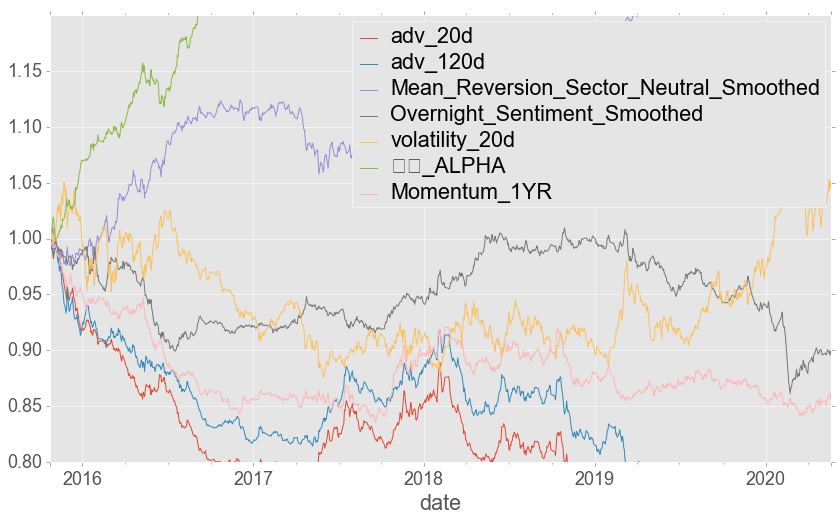

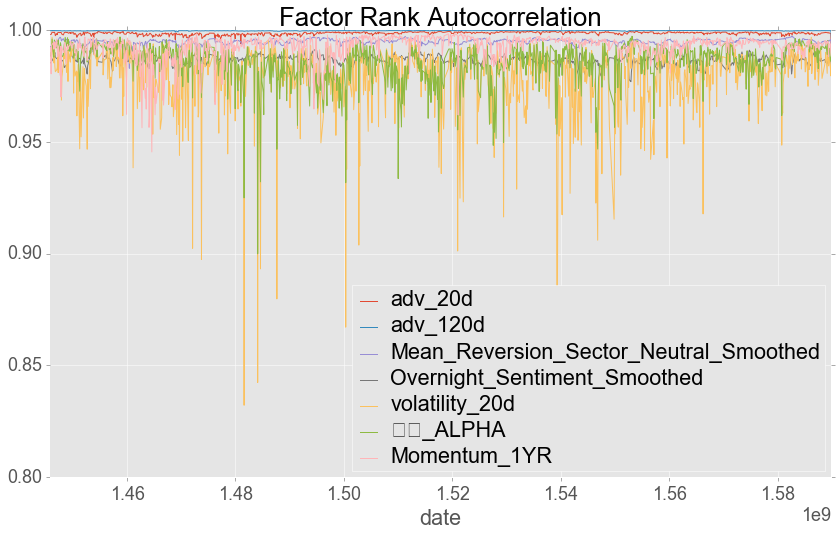

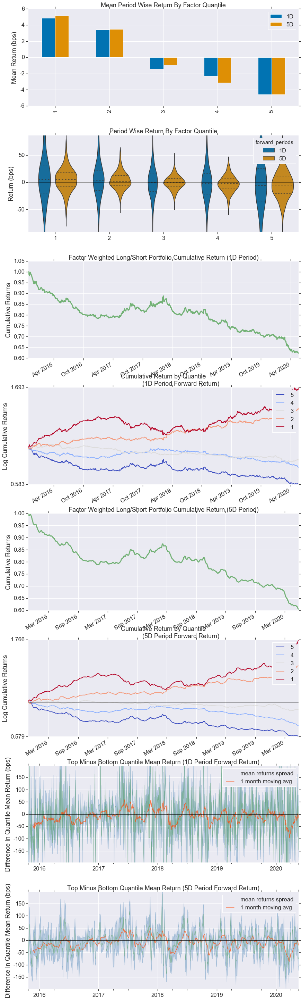

Information Analysis


,1D,5D
IC Mean,-0.01700000,-0.03800000
IC Std.,0.14500000,0.16000000
Risk-Adjusted IC,-0.11500000,-0.23600000
t-stat(IC),-3.84400000,-7.86600000
p-value(IC),0.00000000,0.00000000
IC Skew,0.09100000,0.17700000
IC Kurtosis,0.01500000,-0.21200000


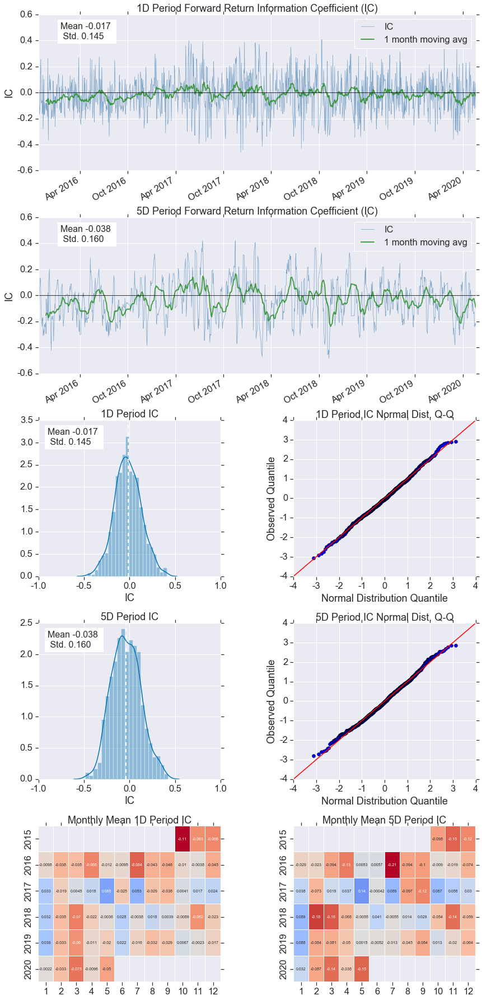

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.03000000,0.11000000
Quantile 2 Mean Turnover,0.06400000,0.22600000
Quantile 3 Mean Turnover,0.07000000,0.25200000
Quantile 4 Mean Turnover,0.05800000,0.21000000
Quantile 5 Mean Turnover,0.02600000,0.09400000


,1D,5D
Mean Factor Rank Autocorrelation,0.99900000,0.98400000


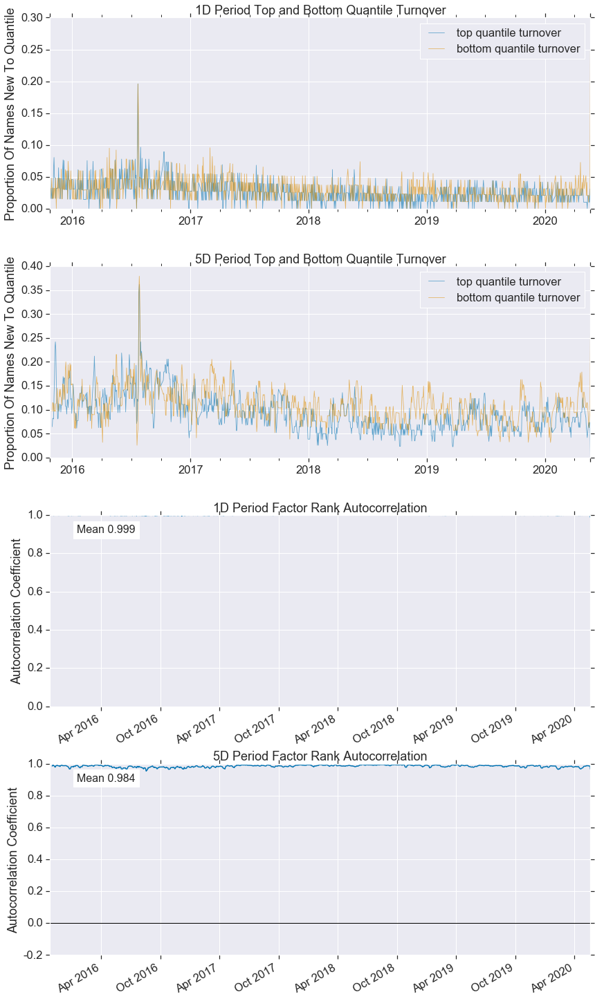

adv_120d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72850515,-0.73825319,-1.31786505,0.21920533,87944,20.10015336
2,-1.06449187,-0.05678871,-0.61244642,0.21083941,87280,19.94839199
3,-0.38170017,0.60033776,0.06825653,0.20663867,87283,19.94907766
4,0.28204647,1.21484445,0.73378271,0.19968156,87280,19.94839199
5,0.99386082,1.72854108,1.40373270,0.19299880,87742,20.05398499


Returns Analysis


,1D,5D
Ann. alpha,-0.08900000,-0.09200000
beta,-0.00800000,-0.03000000
Mean Period Wise Return Top Quantile (bps),-2.91200000,-3.04400000
Mean Period Wise Return Bottom Quantile (bps),4.97700000,5.72600000
Mean Period Wise Spread (bps),-7.68000000,-8.48600000


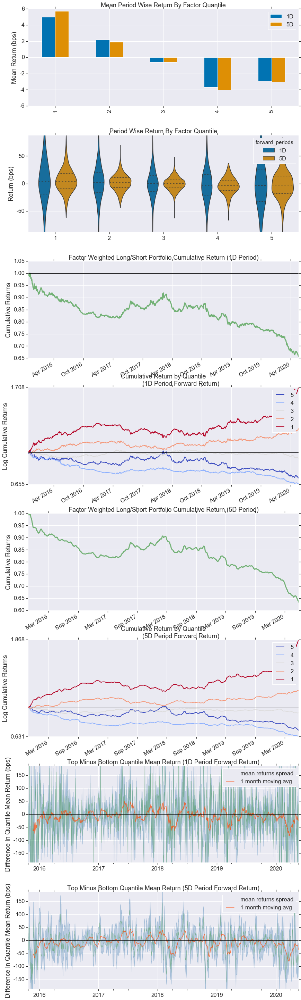

Information Analysis


,1D,5D
IC Mean,-0.00900000,-0.02500000
IC Std.,0.14000000,0.15200000
Risk-Adjusted IC,-0.06200000,-0.16600000
t-stat(IC),-2.07800000,-5.53100000
p-value(IC),0.03800000,0.00000000
IC Skew,0.09900000,0.05500000
IC Kurtosis,0.02000000,-0.26000000


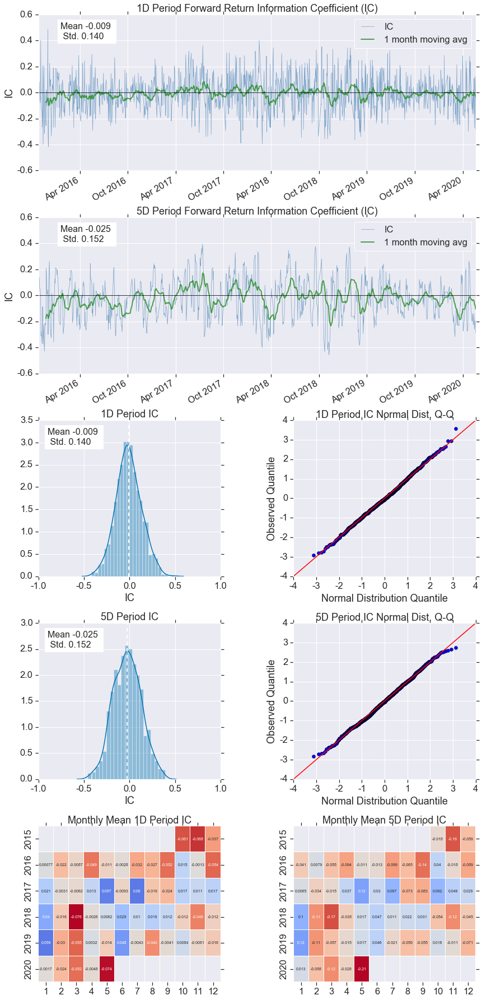

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.01600000,0.05600000
Quantile 2 Mean Turnover,0.02600000,0.08700000
Quantile 3 Mean Turnover,0.02800000,0.09400000
Quantile 4 Mean Turnover,0.02400000,0.07800000
Quantile 5 Mean Turnover,0.01200000,0.03900000


,1D,5D
Mean Factor Rank Autocorrelation,1.00000000,0.99800000


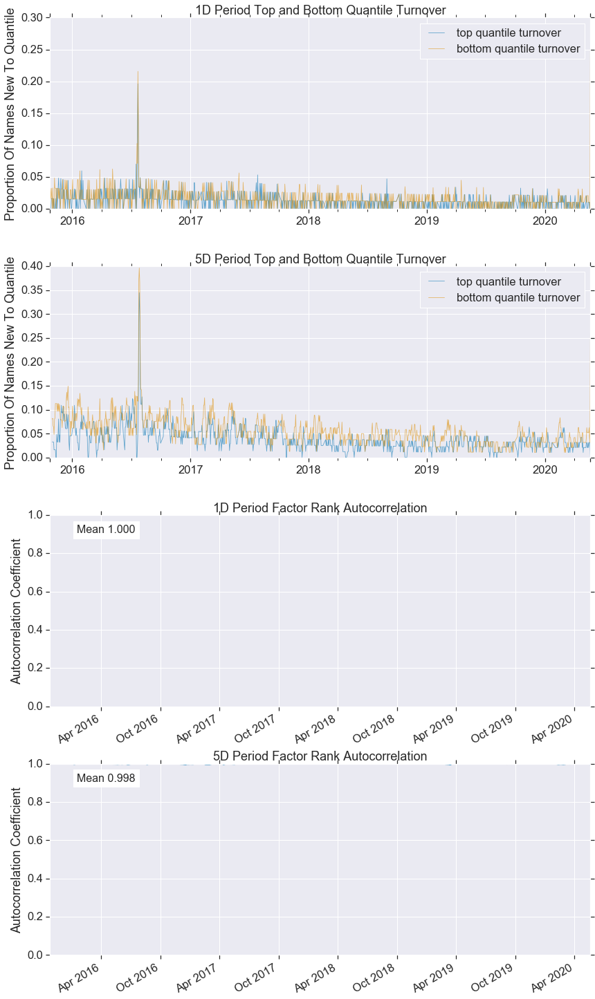

Mean_Reversion_Sector_Neutral_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72850515,-0.74911432,-1.37017118,0.20323334,87944,20.10015336
2,-1.09131913,-0.04763155,-0.68255403,0.19933346,87280,19.94839199
3,-0.45166047,0.61921010,-0.00287487,0.20107484,87283,19.94907766
4,0.20668923,1.15614753,0.68130479,0.20178508,87280,19.94839199
5,0.90668637,1.72851240,1.37424203,0.20494787,87742,20.05398499


Returns Analysis


,1D,5D
Ann. alpha,0.04900000,0.04100000
beta,0.01600000,0.05200000
Mean Period Wise Return Top Quantile (bps),2.86300000,2.37600000
Mean Period Wise Return Bottom Quantile (bps),-1.86300000,-1.40800000
Mean Period Wise Spread (bps),4.81100000,3.86800000


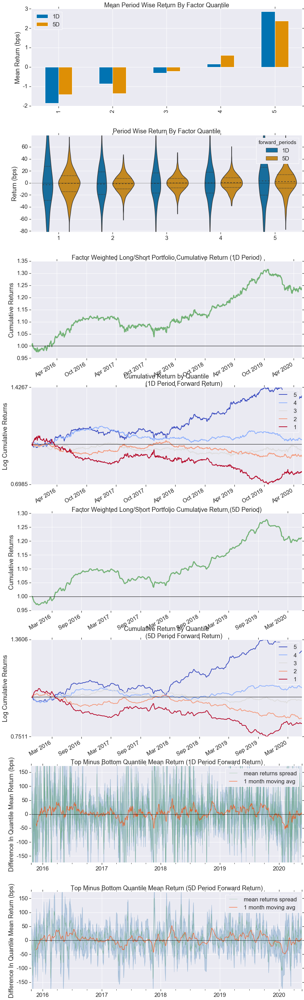

Information Analysis


,1D,5D
IC Mean,0.01100000,0.02100000
IC Std.,0.11900000,0.12300000
Risk-Adjusted IC,0.09200000,0.17300000
t-stat(IC),3.05600000,5.78400000
p-value(IC),0.00200000,0.00000000
IC Skew,0.03900000,0.06500000
IC Kurtosis,0.11800000,0.15600000


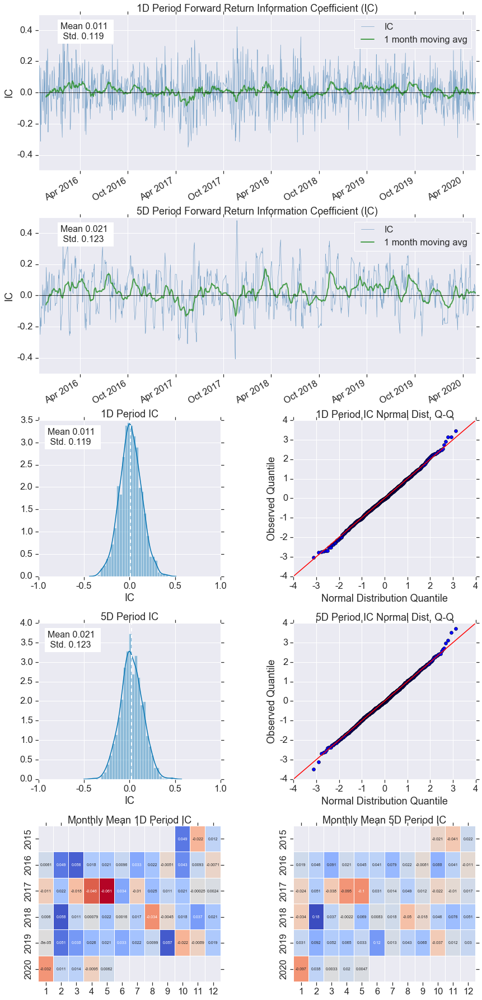

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.06000000,0.26200000
Quantile 2 Mean Turnover,0.13100000,0.53300000
Quantile 3 Mean Turnover,0.14800000,0.58000000
Quantile 4 Mean Turnover,0.13100000,0.53300000
Quantile 5 Mean Turnover,0.06000000,0.26400000


,1D,5D
Mean Factor Rank Autocorrelation,0.99500000,0.90000000


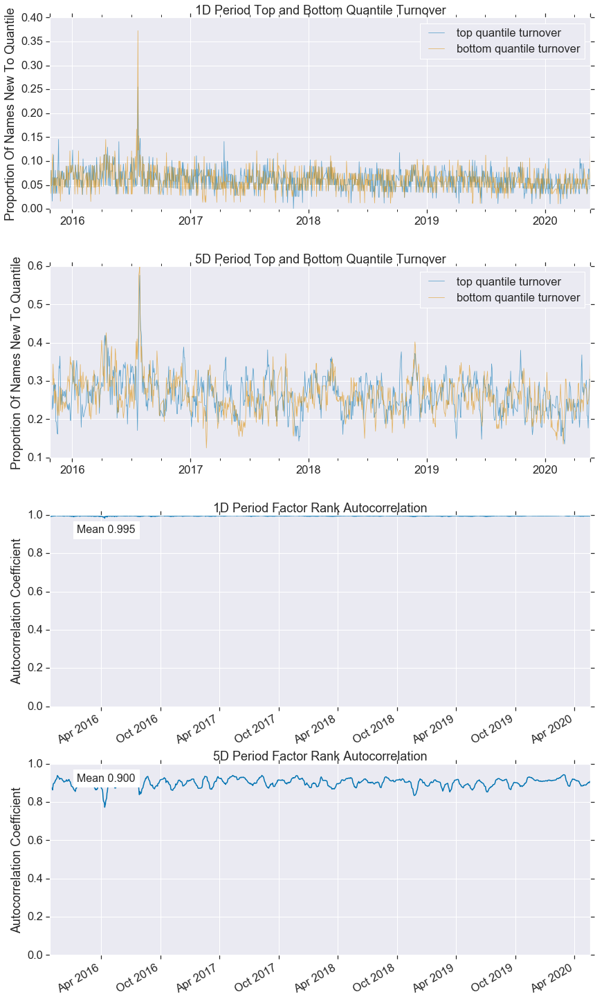

Overnight_Sentiment_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72854108,-0.81723749,-1.37159810,0.20291615,87944,20.10015336
2,-1.16673179,-0.06911959,-0.68927973,0.19910883,87280,19.94839199
3,-0.52767272,0.55702257,-0.01618599,0.20446554,87283,19.94907766
4,0.13294282,1.16690129,0.66793136,0.21525774,87280,19.94839199
5,0.77881655,1.72853395,1.37144383,0.20920155,87742,20.05398499


Returns Analysis


,1D,5D
Ann. alpha,-0.02000000,-0.01100000
beta,-0.04600000,-0.05900000
Mean Period Wise Return Top Quantile (bps),-0.00500000,-0.11300000
Mean Period Wise Return Bottom Quantile (bps),1.47100000,1.12500000
Mean Period Wise Spread (bps),-1.47100000,-1.14100000


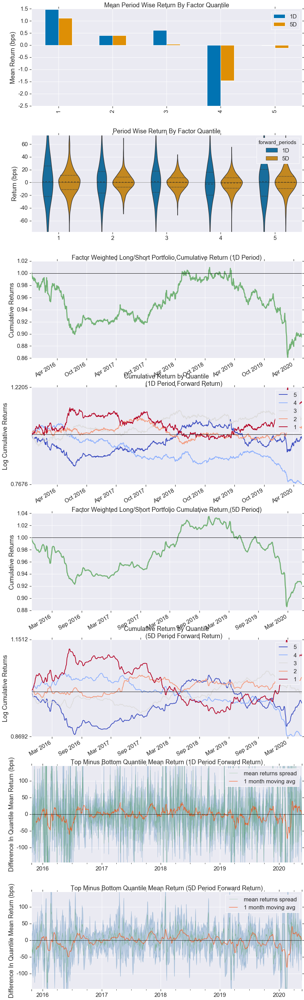

Information Analysis


,1D,5D
IC Mean,0.00200000,0.00300000
IC Std.,0.10000000,0.10500000
Risk-Adjusted IC,0.02500000,0.03000000
t-stat(IC),0.83000000,1.00700000
p-value(IC),0.40700000,0.31400000
IC Skew,-0.12100000,-0.62400000
IC Kurtosis,1.46600000,2.33300000


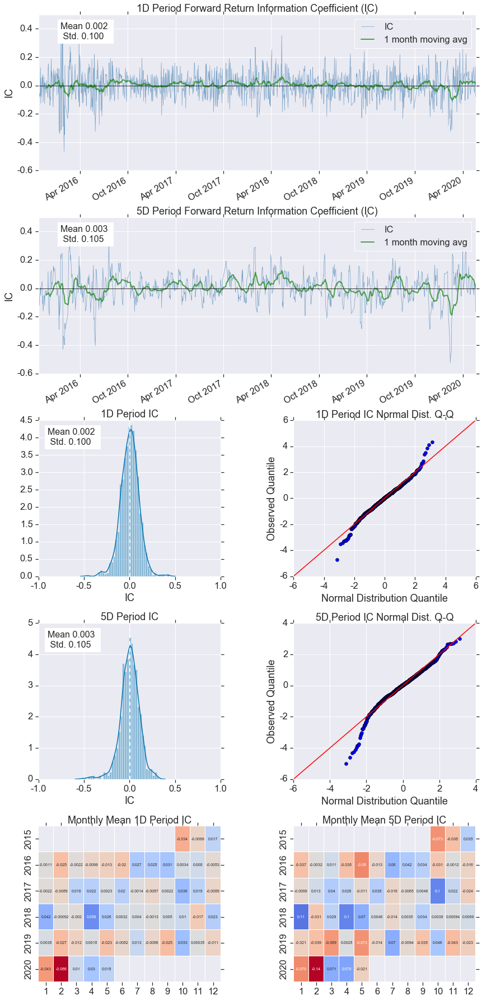

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.09100000,0.37700000
Quantile 2 Mean Turnover,0.20700000,0.65200000
Quantile 3 Mean Turnover,0.24000000,0.69600000
Quantile 4 Mean Turnover,0.21700000,0.66700000
Quantile 5 Mean Turnover,0.09700000,0.40400000


,1D,5D
Mean Factor Rank Autocorrelation,0.98700000,0.76100000


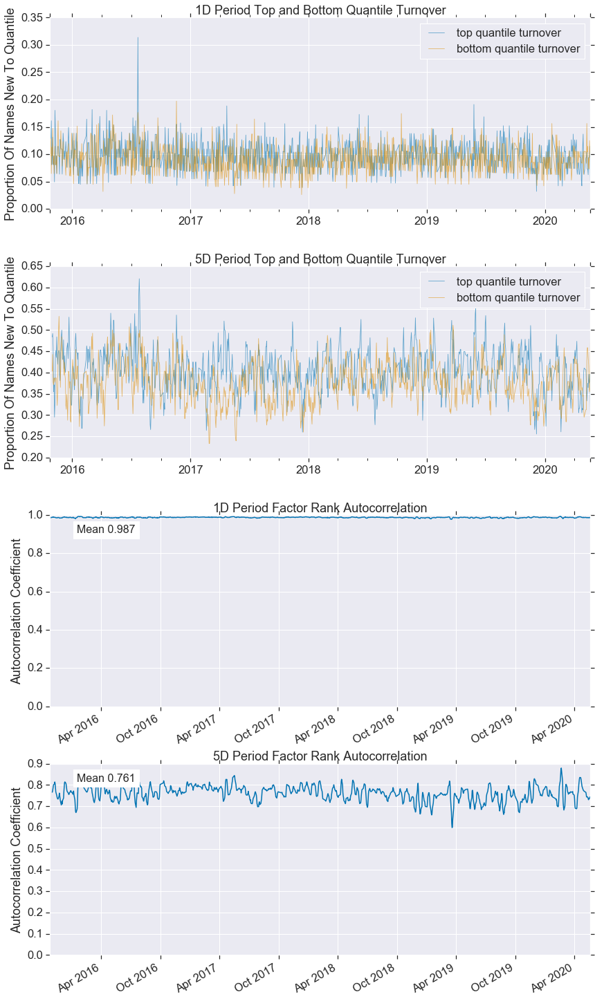

volatility_20d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72851961,-1.00025240,-1.39553580,0.19058354,87944,20.10015336
2,-1.23657787,-0.33191363,-0.73412917,0.19657967,87280,19.94839199
3,-0.64369807,0.35770699,-0.06379974,0.20081086,87283,19.94907766
4,0.10163654,1.07080313,0.62308412,0.20770140,87280,19.94839199
5,0.77921345,1.72854108,1.33916859,0.21840145,87742,20.05398499


Returns Analysis


,1D,5D
Ann. alpha,-0.00500000,-0.01100000
beta,0.22200000,0.21300000
Mean Period Wise Return Top Quantile (bps),-0.50900000,-0.89700000
Mean Period Wise Return Bottom Quantile (bps),-3.11500000,-2.76700000
Mean Period Wise Spread (bps),1.43800000,0.88300000


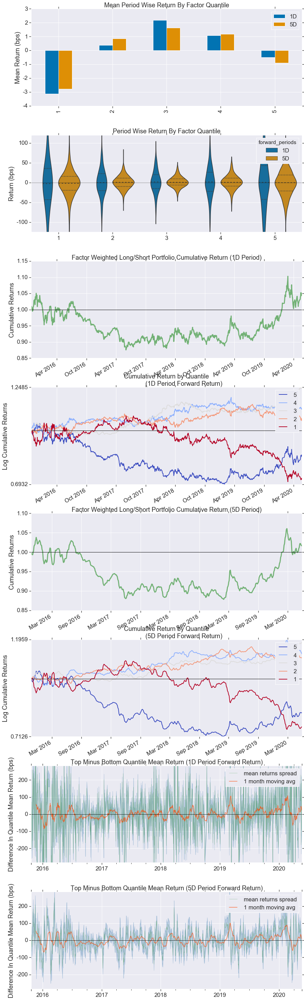

Information Analysis


,1D,5D
IC Mean,-0.01900000,-0.03000000
IC Std.,0.21700000,0.20800000
Risk-Adjusted IC,-0.08700000,-0.14300000
t-stat(IC),-2.90400000,-4.76300000
p-value(IC),0.00400000,0.00000000
IC Skew,0.21800000,0.07600000
IC Kurtosis,-0.18500000,-0.47600000


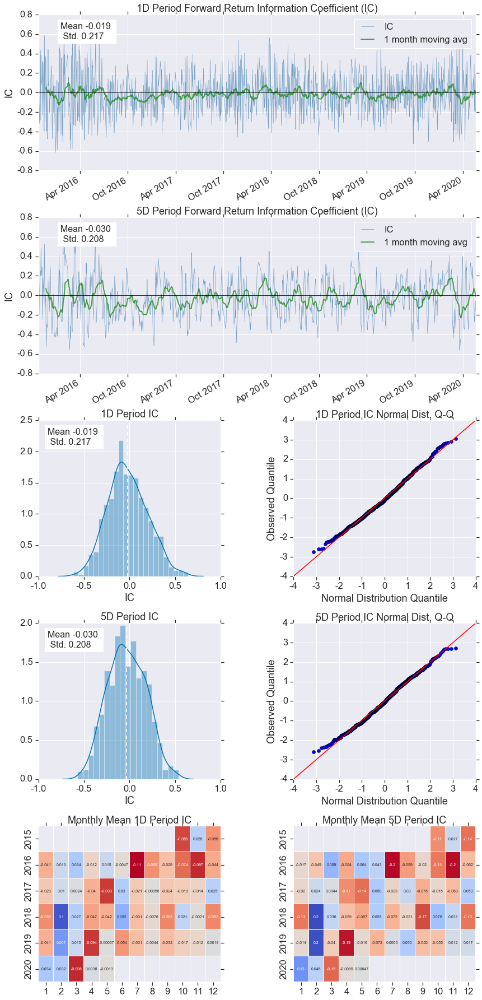

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.07900000,0.21400000
Quantile 2 Mean Turnover,0.17600000,0.43700000
Quantile 3 Mean Turnover,0.19900000,0.48200000
Quantile 4 Mean Turnover,0.18000000,0.45200000
Quantile 5 Mean Turnover,0.08700000,0.25100000


,1D,5D
Mean Factor Rank Autocorrelation,0.97900000,0.89300000


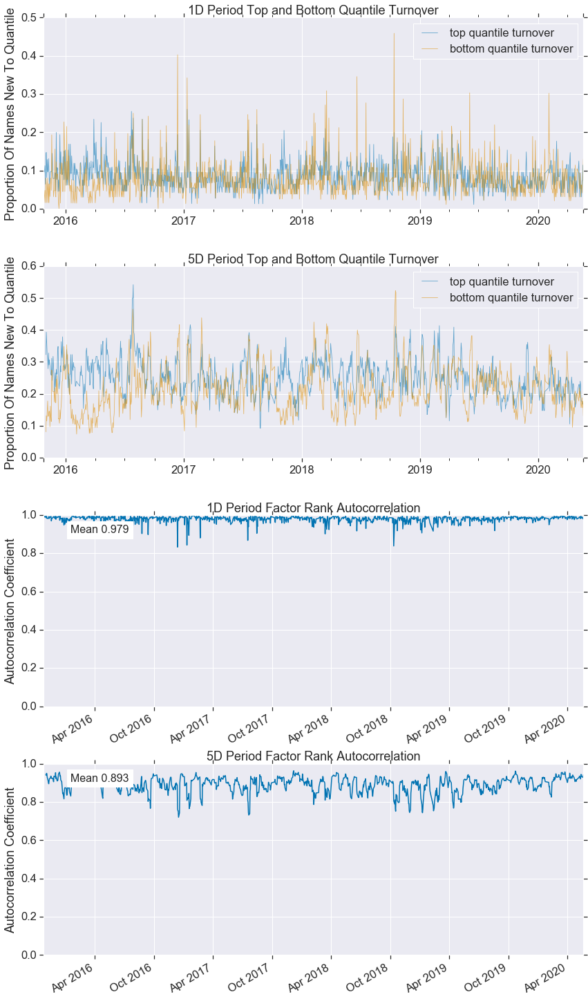

增强_ALPHA
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.03511142,-0.00095494,-0.01578513,0.00634235,87944,20.10015336
2,-0.01655657,0.00520913,-0.00433185,0.00418207,87280,19.94839199
3,-0.00872818,0.01048424,0.00263626,0.00352509,87283,19.94907766
4,0.00123747,0.02524758,0.01186011,0.00377205,87280,19.94839199
5,0.01009088,0.03819603,0.02048554,0.00512228,87742,20.05398499


Returns Analysis


,1D,5D
Ann. alpha,0.15400000,0.15300000
beta,-0.09600000,-0.07400000
Mean Period Wise Return Top Quantile (bps),5.67200000,5.61500000
Mean Period Wise Return Bottom Quantile (bps),-5.57300000,-5.94500000
Mean Period Wise Spread (bps),11.75900000,11.90800000


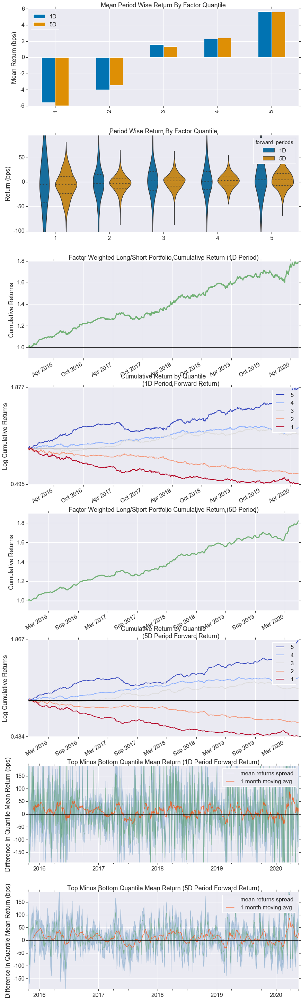

Information Analysis


,1D,5D
IC Mean,0.03100000,0.06300000
IC Std.,0.13100000,0.12900000
Risk-Adjusted IC,0.23500000,0.49000000
t-stat(IC),7.83900000,16.34800000
p-value(IC),0.00000000,0.00000000
IC Skew,-0.02800000,0.17100000
IC Kurtosis,0.20800000,-0.38900000


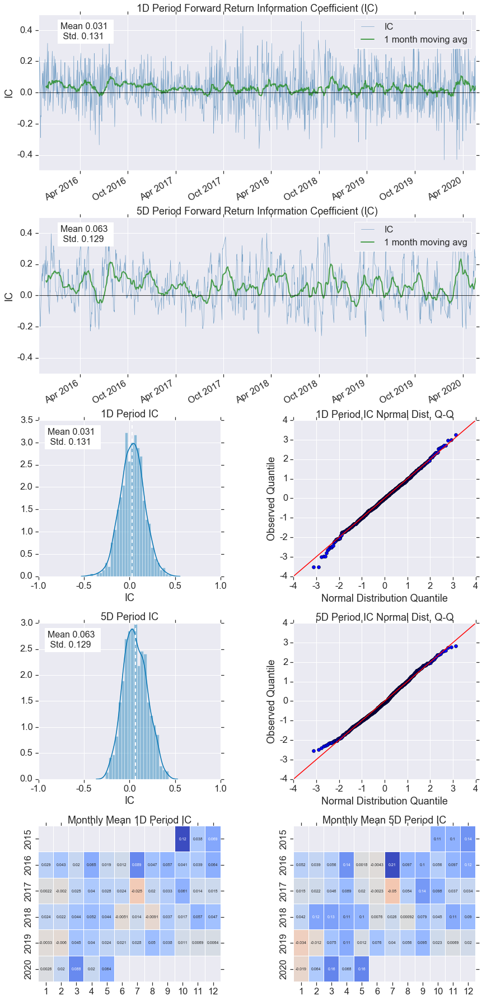

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.08100000,0.23000000
Quantile 2 Mean Turnover,0.16600000,0.39100000
Quantile 3 Mean Turnover,0.17000000,0.40300000
Quantile 4 Mean Turnover,0.14300000,0.35300000
Quantile 5 Mean Turnover,0.06800000,0.19000000


,1D,5D
Mean Factor Rank Autocorrelation,0.98600000,0.91900000


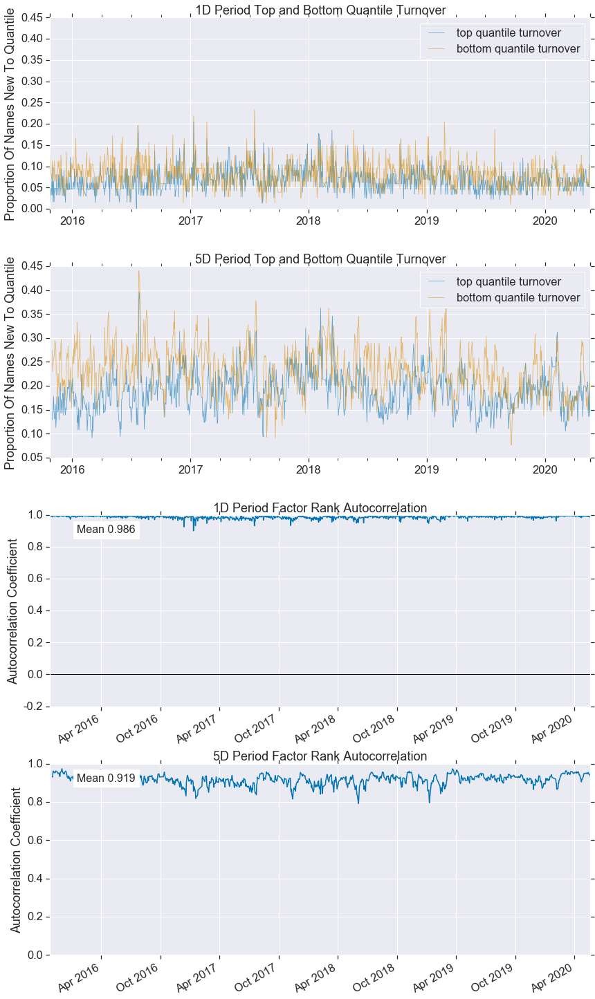

Momentum_1YR
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72844612,-0.99423310,-1.38319239,0.20111017,87944,20.10015336
2,-1.06660745,-0.29031651,-0.68979778,0.19975647,87280,19.94839199
3,-0.39656607,0.44569606,0.00123544,0.19973463,87283,19.94907766
4,0.29880536,1.05998260,0.69110906,0.19939242,87280,19.94839199
5,0.97653146,1.72844612,1.38299348,0.20085698,87742,20.05398499


Returns Analysis


,1D,5D
Ann. alpha,-0.03200000,-0.03300000
beta,-0.01400000,-0.03300000
Mean Period Wise Return Top Quantile (bps),-1.41800000,-1.02300000
Mean Period Wise Return Bottom Quantile (bps),1.31300000,1.67800000
Mean Period Wise Spread (bps),-3.29000000,-3.19000000


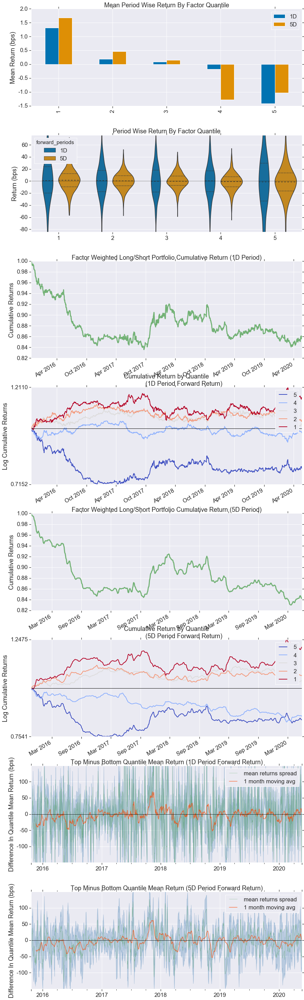

Information Analysis


,1D,5D
IC Mean,0.00000000,-0.00100000
IC Std.,0.11100000,0.12200000
Risk-Adjusted IC,0.00100000,-0.00400000
t-stat(IC),0.02400000,-0.14600000
p-value(IC),0.98100000,0.88400000
IC Skew,0.09900000,0.15000000
IC Kurtosis,0.44500000,0.42000000


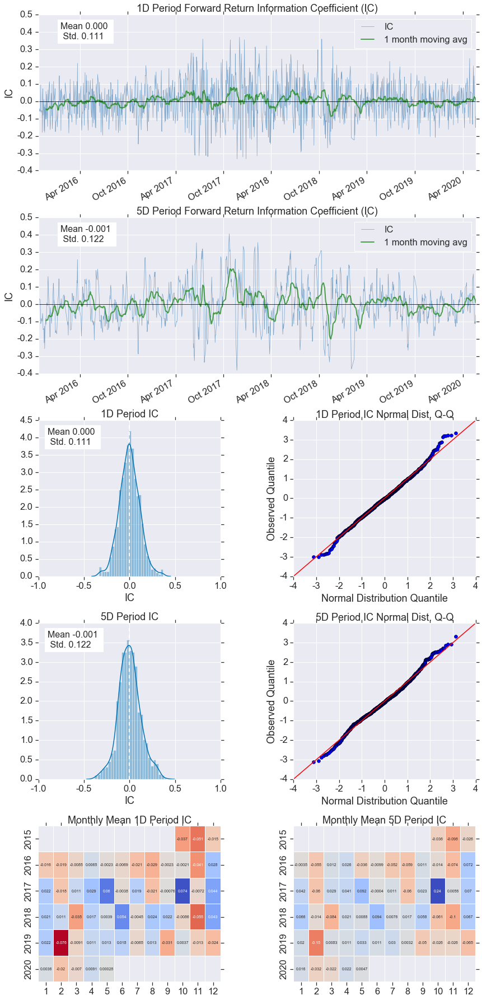

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.05500000,0.13200000
Quantile 2 Mean Turnover,0.12100000,0.27200000
Quantile 3 Mean Turnover,0.14200000,0.30800000
Quantile 4 Mean Turnover,0.12400000,0.27400000
Quantile 5 Mean Turnover,0.05700000,0.13500000


,1D,5D
Mean Factor Rank Autocorrelation,0.99300000,0.96500000


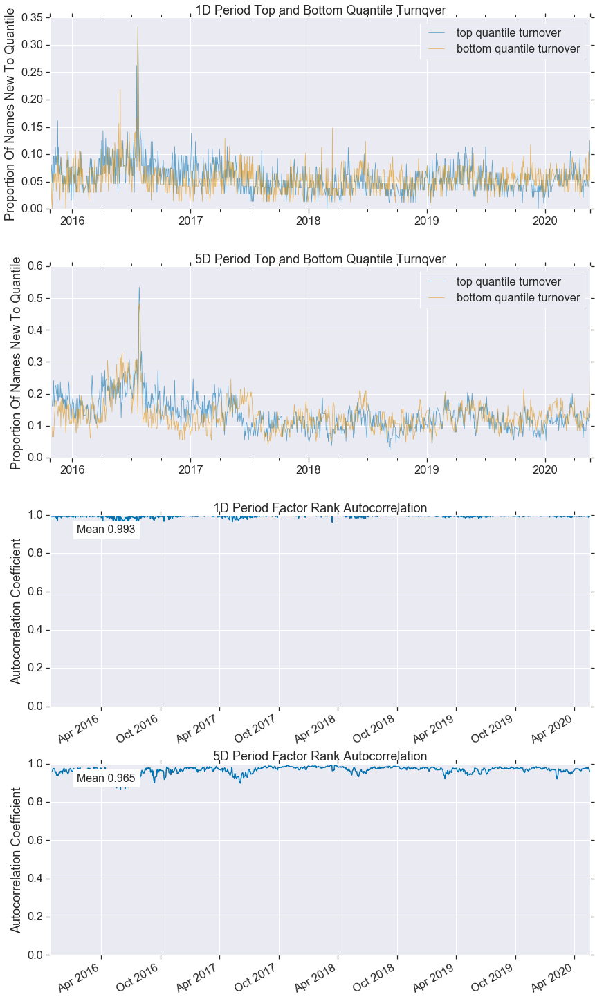

adv_20d                                  -0.01672810
adv_120d                                 -0.00868607
Mean_Reversion_Sector_Neutral_Smoothed    0.01090350
Overnight_Sentiment_Smoothed              0.00247899
volatility_20d                           -0.01884817
增强_ALPHA                                  0.03075204
Momentum_1YR                              0.00007909
dtype: float64


In [11]:
n_trees = 300
n_skip_samples = 4
# n_skip_samples = 9

clf = RandomForestClassifier(n_trees, **clf_parameters)
clf_nov = NoOverlapVoter(clf, n_skip_samples =n_skip_samples)
clf_nov.fit(
    pd.concat([X_train, X_valid]),
    pd.concat([y_train, y_valid]))

print('train: {}, oob: {}, valid: {}'.format(
    clf_nov.score(X_train, y_train.values),
    clf_nov.score(X_valid, y_valid.values),
    clf_nov.oob_score_))

factor_IC = show_sample_results(all_factors, pd.concat([X_train, X_valid]), clf_nov, factor_names)

#### Test

[ 0.49409496  0.50590504]
Cleaning Data...

Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.1% entries from factor data: 0.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss

,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72857628,-0.99966259,-1.37265374,0.20055831,9780,20.08419756
2,-1.06237342,-0.30545246,-0.68302863,0.19951086,9715,19.95071363
3,-0.48034706,0.37487347,0.00314909,0.19913175,9718,19.95687442
4,0.22790189,1.06079631,0.69043515,0.20054992,9715,19.95071363
5,0.95718793,1.72859016,1.38718766,0.20066726,9767,20.05750077


Returns Analysis


,1D,5D
Ann. alpha,-0.38000000,-0.36900000
beta,0.05100000,0.01200000
Mean Period Wise Return Top Quantile (bps),-13.55700000,-11.73000000
Mean Period Wise Return Bottom Quantile (bps),29.15700000,31.27600000
Mean Period Wise Spread (bps),-42.80700000,-43.02100000


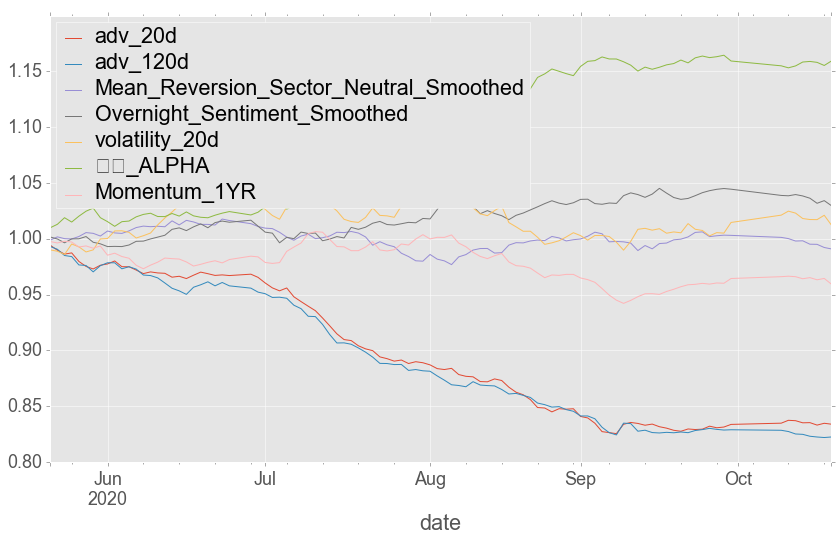

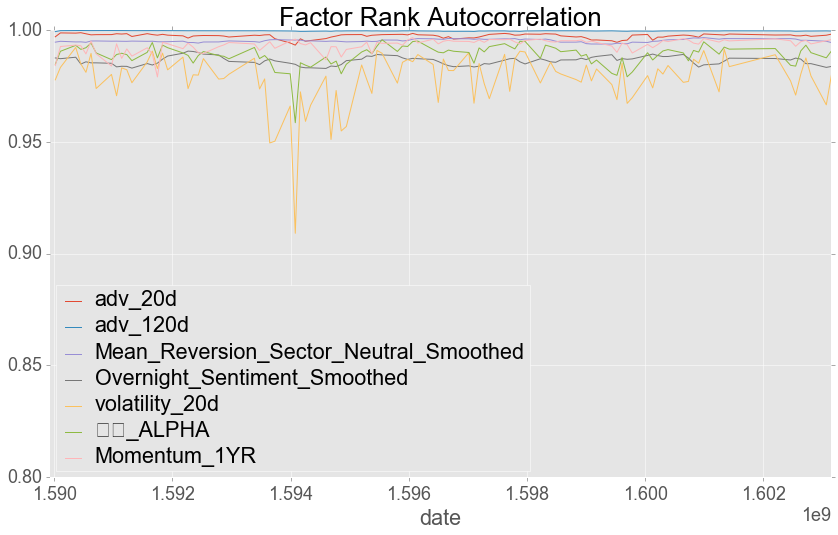

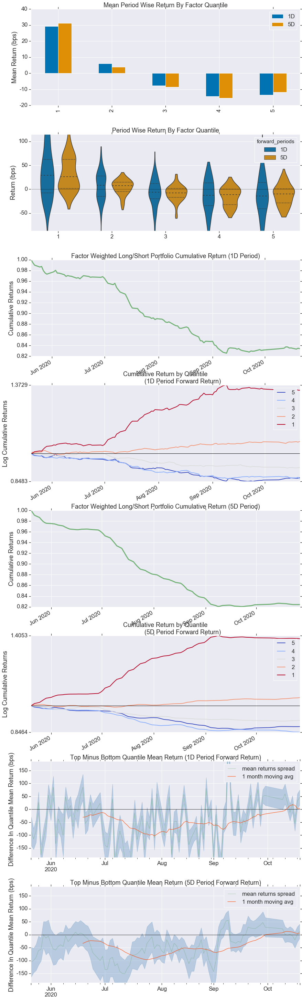

Information Analysis


,1D,5D
IC Mean,-0.03900000,-0.07800000
IC Std.,0.09900000,0.12000000
Risk-Adjusted IC,-0.39200000,-0.65200000
t-stat(IC),-3.96300000,-6.59000000
p-value(IC),0.00000000,0.00000000
IC Skew,0.19400000,-0.07400000
IC Kurtosis,0.13600000,-0.69900000


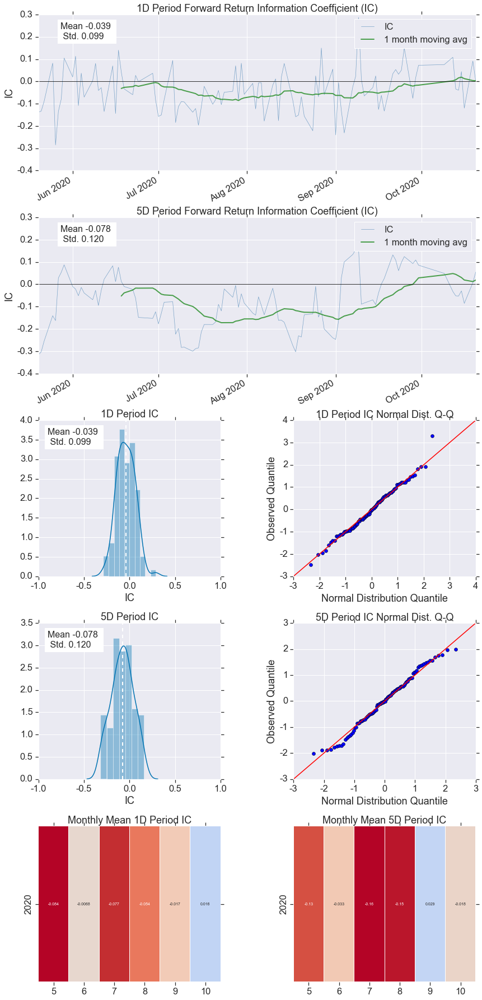

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.04300000,0.16800000
Quantile 2 Mean Turnover,0.09500000,0.34800000
Quantile 3 Mean Turnover,0.09600000,0.34900000
Quantile 4 Mean Turnover,0.06700000,0.25100000
Quantile 5 Mean Turnover,0.02700000,0.09300000


,1D,5D
Mean Factor Rank Autocorrelation,0.99700000,0.96300000


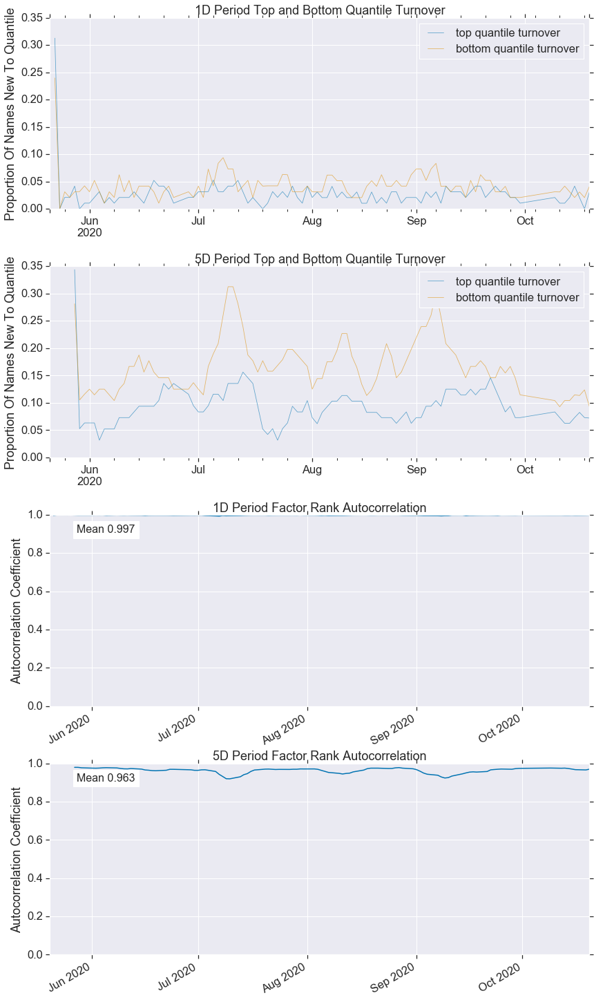

adv_120d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72858323,-0.97428056,-1.36054068,0.20874335,9780,20.08419756
2,-1.05536106,-0.29851036,-0.66267870,0.19804427,9715,19.95071363
3,-0.41723577,0.38181557,0.02023207,0.19721722,9718,19.95687442
4,0.23491425,1.06507373,0.70328214,0.19824709,9715,19.95071363
5,1.00627449,1.72859016,1.39400529,0.19569931,9767,20.05750077


Returns Analysis


,1D,5D
Ann. alpha,-0.39800000,-0.38500000
beta,0.04200000,-0.00200000
Mean Period Wise Return Top Quantile (bps),-9.22300000,-8.73000000
Mean Period Wise Return Bottom Quantile (bps),39.35400000,40.64300000
Mean Period Wise Spread (bps),-48.86700000,-49.51700000


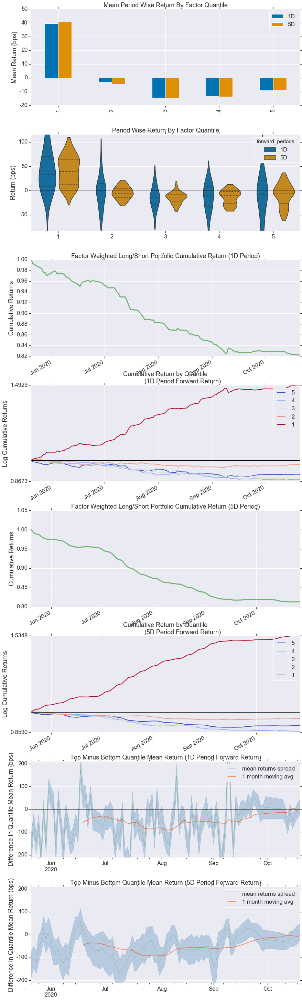

Information Analysis


,1D,5D
IC Mean,-0.03000000,-0.06400000
IC Std.,0.09000000,0.10400000
Risk-Adjusted IC,-0.32800000,-0.61900000
t-stat(IC),-3.31300000,-6.25600000
p-value(IC),0.00100000,0.00000000
IC Skew,0.48300000,-0.15100000
IC Kurtosis,0.76600000,-0.15600000


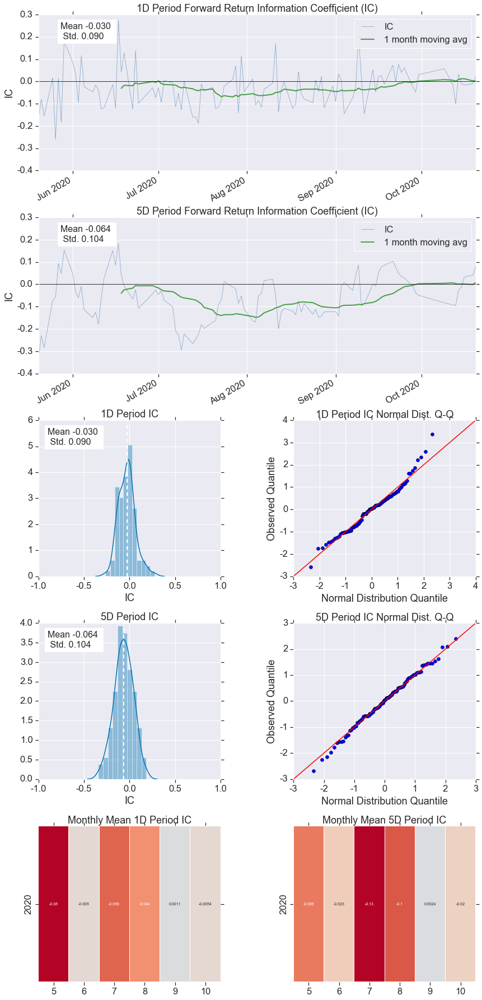

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.01800000,0.06300000
Quantile 2 Mean Turnover,0.03200000,0.11700000
Quantile 3 Mean Turnover,0.03000000,0.10100000
Quantile 4 Mean Turnover,0.02000000,0.06400000
Quantile 5 Mean Turnover,0.00900000,0.02400000


,1D,5D
Mean Factor Rank Autocorrelation,1.00000000,0.99700000


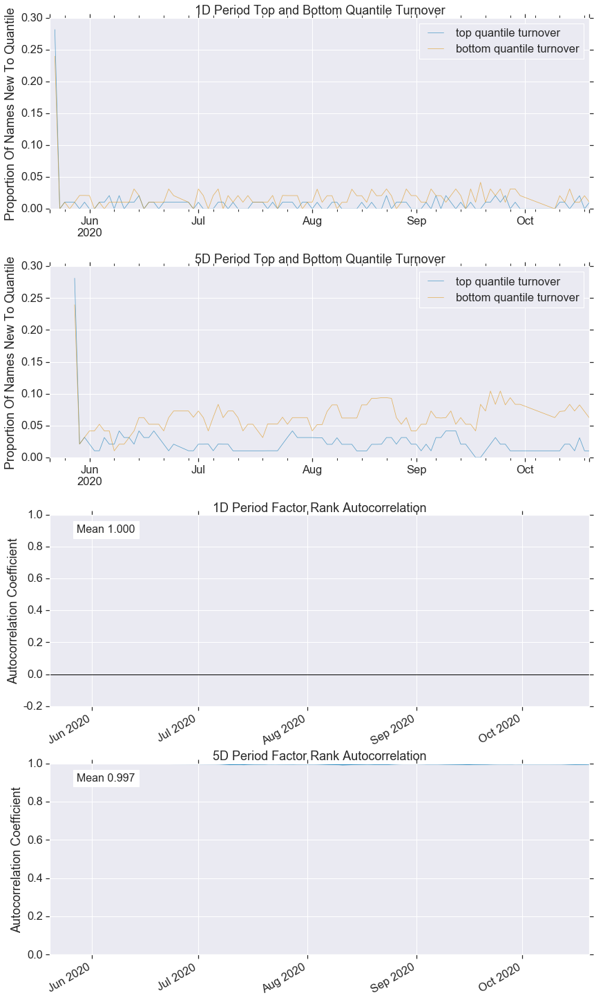

Mean_Reversion_Sector_Neutral_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72855524,-0.98924244,-1.37629758,0.20277766,9780,20.08419756
2,-1.04972990,-0.30627791,-0.68418527,0.19827699,9715,19.95071363
3,-0.38253963,0.37668662,-0.00098103,0.19851089,9718,19.95687442
4,0.30792077,1.05965116,0.68695923,0.20091802,9715,19.95071363
5,1.00774071,1.72855524,1.38416146,0.20221523,9767,20.05750077


Returns Analysis


,1D,5D
Ann. alpha,0.01600000,0.02900000
beta,-0.06300000,-0.06000000
Mean Period Wise Return Top Quantile (bps),-2.41700000,-2.09300000
Mean Period Wise Return Bottom Quantile (bps),-0.70000000,-2.57600000
Mean Period Wise Spread (bps),-1.85800000,0.49400000


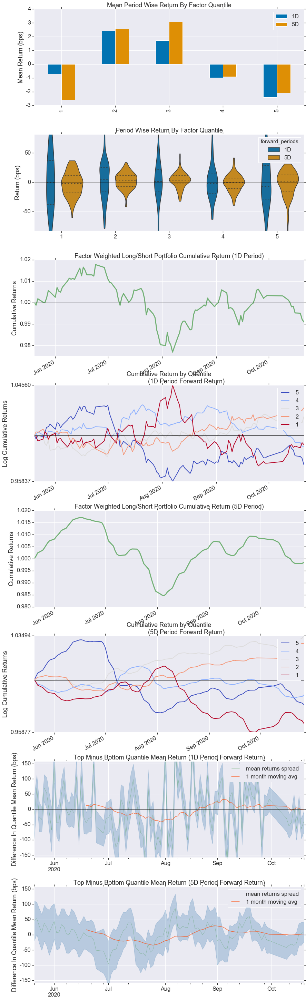

Information Analysis


,1D,5D
IC Mean,0.00400000,0.01600000
IC Std.,0.09000000,0.09100000
Risk-Adjusted IC,0.04900000,0.17900000
t-stat(IC),0.49800000,1.80500000
p-value(IC),0.62000000,0.07400000
IC Skew,0.27600000,-0.34700000
IC Kurtosis,-0.51400000,-0.58500000


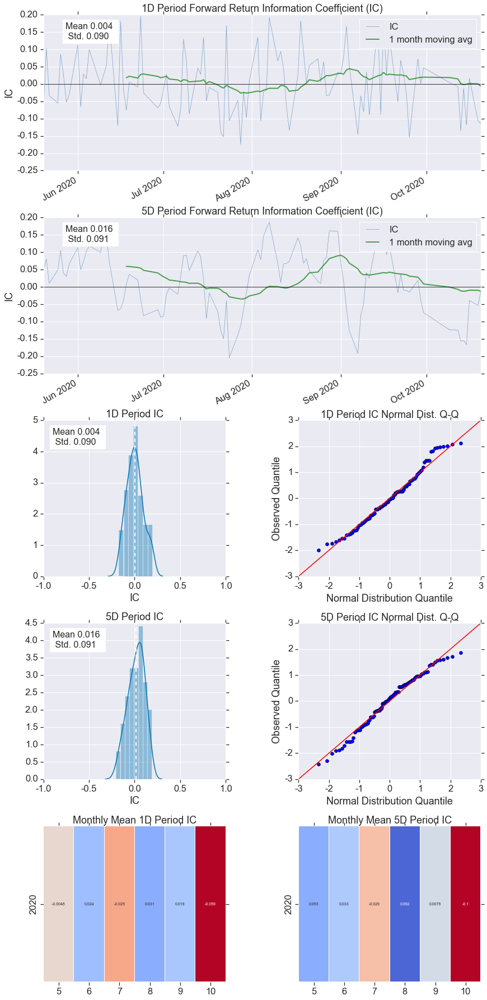

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.05600000,0.24500000
Quantile 2 Mean Turnover,0.12700000,0.53600000
Quantile 3 Mean Turnover,0.14600000,0.57300000
Quantile 4 Mean Turnover,0.12700000,0.53200000
Quantile 5 Mean Turnover,0.05600000,0.24300000


,1D,5D
Mean Factor Rank Autocorrelation,0.99500000,0.90400000


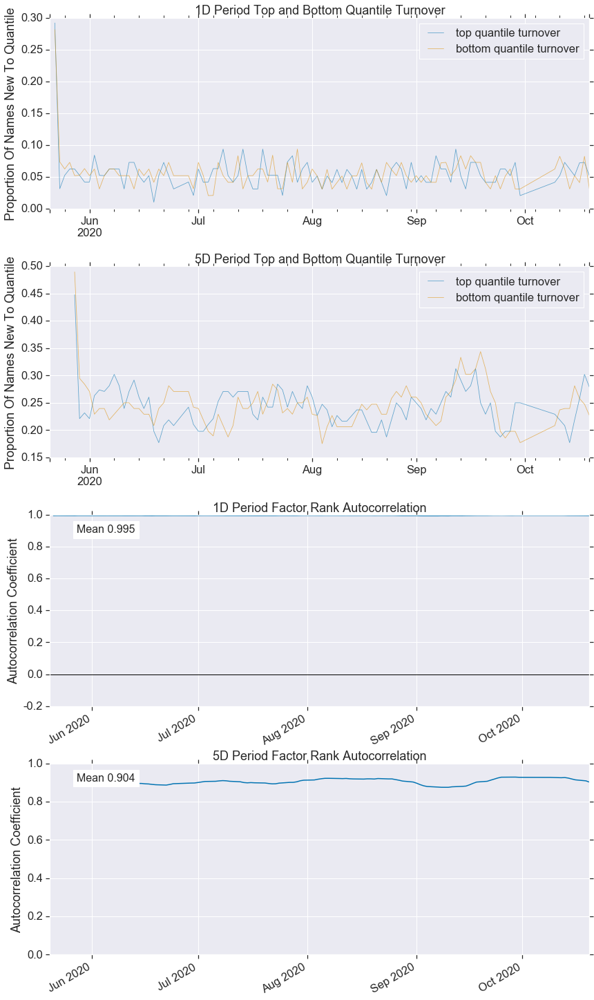

Overnight_Sentiment_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72859016,-0.98974532,-1.37151145,0.20673966,9780,20.08419756
2,-1.04133632,-0.29851036,-0.66953449,0.20051034,9715,19.95071363
3,-0.35412447,0.38875768,0.01781133,0.19781074,9718,19.95687442
4,0.32607501,1.06214151,0.70006814,0.19719278,9715,19.95071363
5,1.02029923,1.72859016,1.38191702,0.19824473,9767,20.05750077


Returns Analysis


,1D,5D
Ann. alpha,0.08200000,0.08200000
beta,-0.00800000,-0.00300000
Mean Period Wise Return Top Quantile (bps),1.88900000,3.49000000
Mean Period Wise Return Bottom Quantile (bps),-3.66800000,-4.19900000
Mean Period Wise Spread (bps),5.56800000,7.61700000


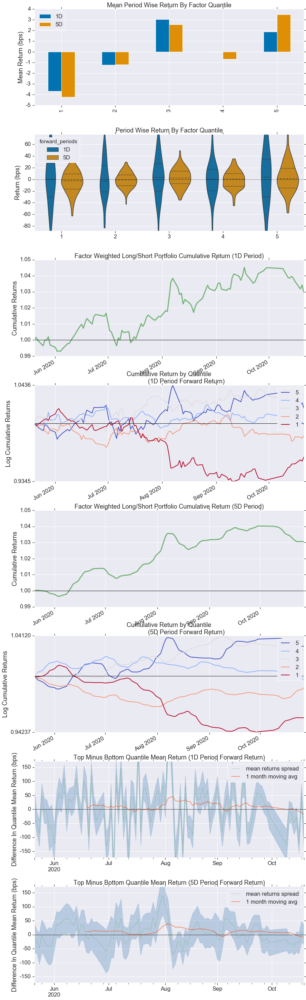

Information Analysis


,1D,5D
IC Mean,0.01600000,0.02200000
IC Std.,0.09800000,0.09500000
Risk-Adjusted IC,0.16300000,0.23700000
t-stat(IC),1.65100000,2.39800000
p-value(IC),0.10200000,0.01800000
IC Skew,-0.06500000,-0.14900000
IC Kurtosis,-0.31700000,-0.45400000


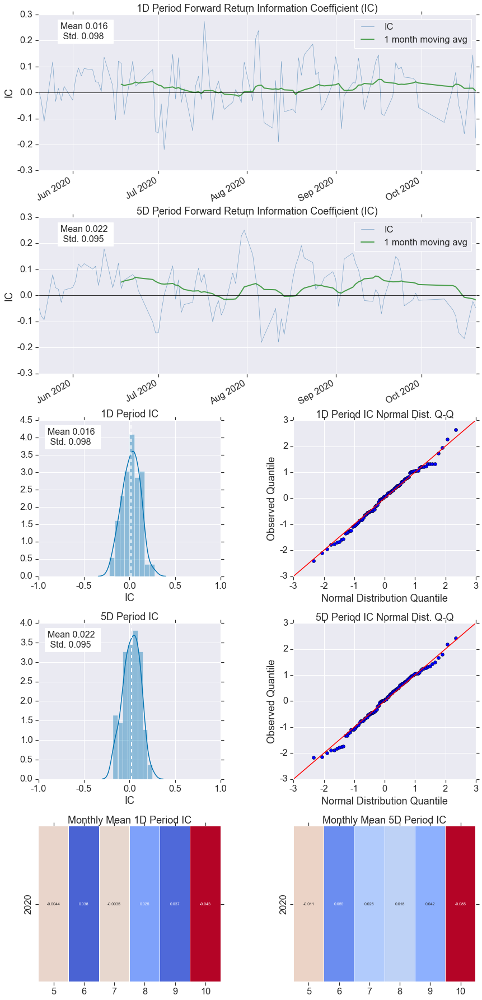

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.09100000,0.37500000
Quantile 2 Mean Turnover,0.21200000,0.65800000
Quantile 3 Mean Turnover,0.24300000,0.69800000
Quantile 4 Mean Turnover,0.21300000,0.66000000
Quantile 5 Mean Turnover,0.09400000,0.39500000


,1D,5D
Mean Factor Rank Autocorrelation,0.98600000,0.75000000


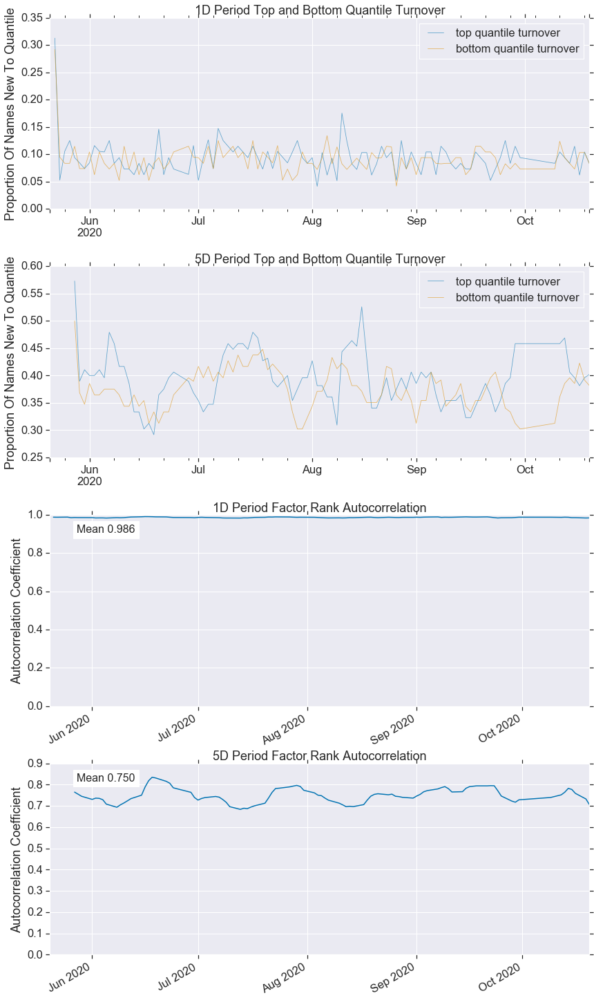

volatility_20d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72859016,-1.02029923,-1.38278803,0.19850108,9780,20.08419756
2,-1.05519940,-0.34430290,-0.70154390,0.19540939,9715,19.95071363
3,-0.38181557,0.34016297,-0.02443375,0.19636436,9718,19.95687442
4,0.29392437,1.03297214,0.66027954,0.19955779,9715,19.95071363
5,0.97428056,1.72858323,1.36771311,0.21089701,9767,20.05750077


Returns Analysis


,1D,5D
Ann. alpha,-0.06600000,-0.07000000
beta,0.17100000,0.14200000
Mean Period Wise Return Top Quantile (bps),3.35800000,2.30000000
Mean Period Wise Return Bottom Quantile (bps),-2.86200000,-0.25200000
Mean Period Wise Spread (bps),5.92700000,2.52400000


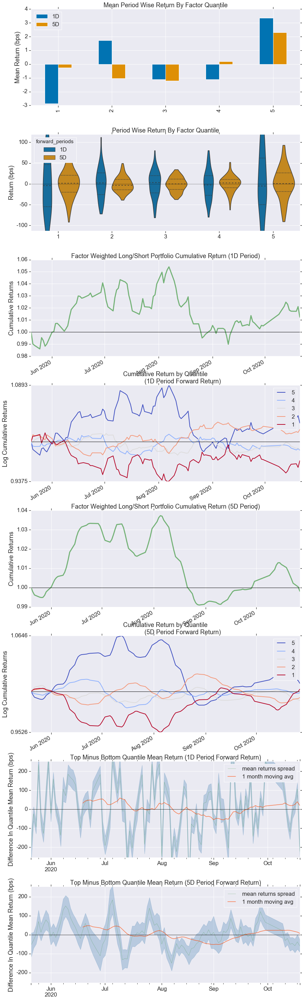

Information Analysis


,1D,5D
IC Mean,-0.03000000,-0.04800000
IC Std.,0.17900000,0.18300000
Risk-Adjusted IC,-0.16800000,-0.26300000
t-stat(IC),-1.69500000,-2.66000000
p-value(IC),0.09300000,0.00900000
IC Skew,0.19600000,0.18300000
IC Kurtosis,-0.43900000,-0.79800000


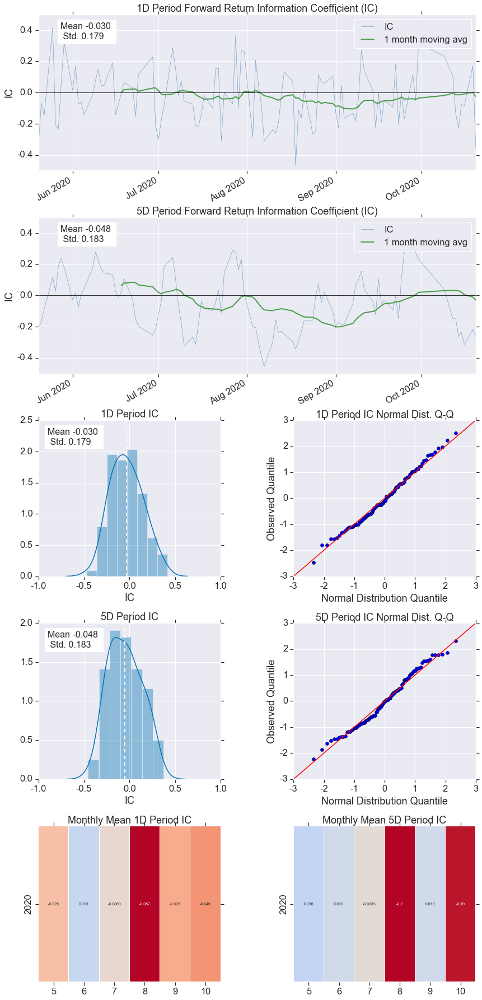

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.08700000,0.23300000
Quantile 2 Mean Turnover,0.19300000,0.46900000
Quantile 3 Mean Turnover,0.21600000,0.51600000
Quantile 4 Mean Turnover,0.18000000,0.45500000
Quantile 5 Mean Turnover,0.07600000,0.22200000


,1D,5D
Mean Factor Rank Autocorrelation,0.97800000,0.87900000


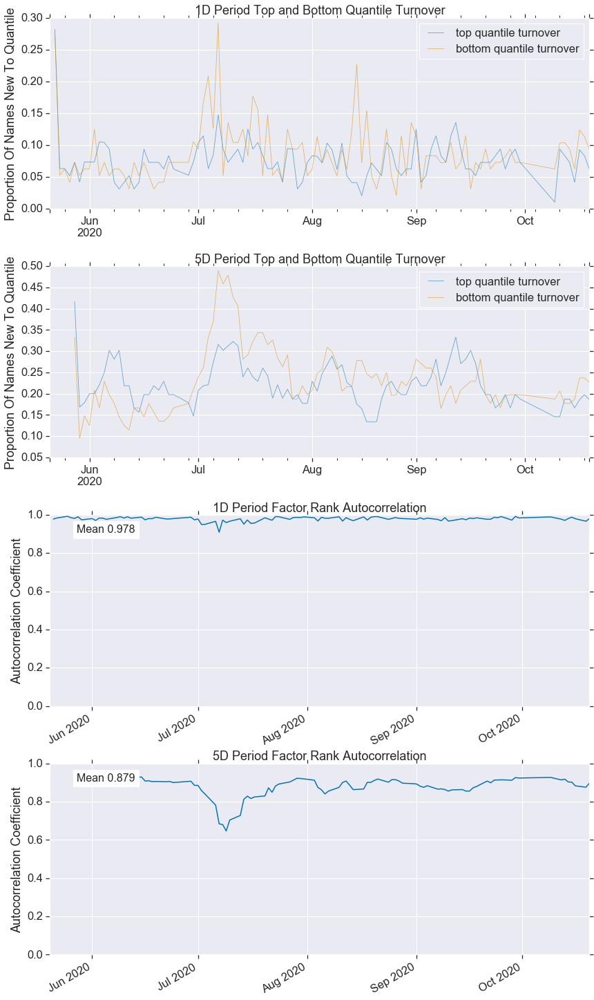

增强_ALPHA
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.03427120,-0.00741187,-0.01843212,0.00543414,9780,20.08419756
2,-0.01494389,-0.00024996,-0.00697741,0.00300864,9715,19.95071363
3,-0.00737761,0.01055844,0.00232200,0.00381006,9718,19.95687442
4,0.00598517,0.02251543,0.01445943,0.00343719,9715,19.95071363
5,0.01744336,0.03809858,0.02439344,0.00329213,9767,20.05750077


Returns Analysis


,1D,5D
Ann. alpha,0.53200000,0.49900000
beta,-0.10000000,-0.06400000
Mean Period Wise Return Top Quantile (bps),17.91400000,19.17900000
Mean Period Wise Return Bottom Quantile (bps),-16.14300000,-16.04500000
Mean Period Wise Spread (bps),34.50700000,35.36500000


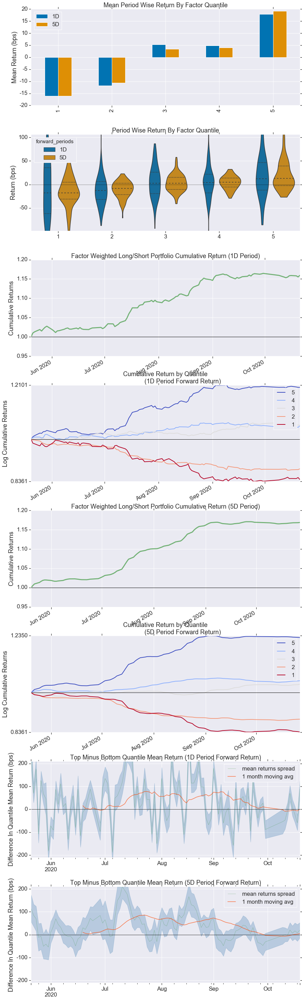

Information Analysis


,1D,5D
IC Mean,0.04700000,0.08900000
IC Std.,0.11100000,0.12900000
Risk-Adjusted IC,0.42600000,0.69100000
t-stat(IC),4.30100000,6.97800000
p-value(IC),0.00000000,0.00000000
IC Skew,-0.15300000,0.40600000
IC Kurtosis,-0.32100000,-0.31200000


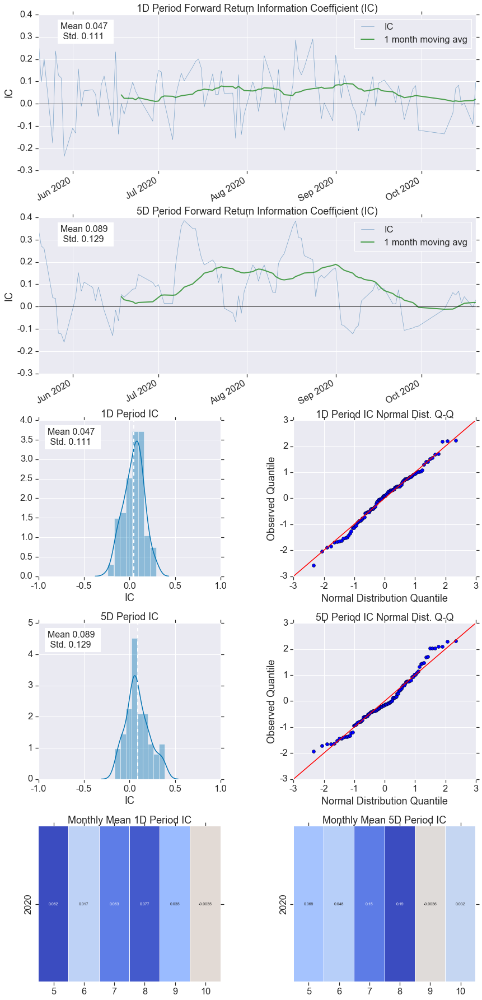

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.07700000,0.23600000
Quantile 2 Mean Turnover,0.15400000,0.38100000
Quantile 3 Mean Turnover,0.15300000,0.42800000
Quantile 4 Mean Turnover,0.12600000,0.36200000
Quantile 5 Mean Turnover,0.05900000,0.18400000


,1D,5D
Mean Factor Rank Autocorrelation,0.98900000,0.91400000


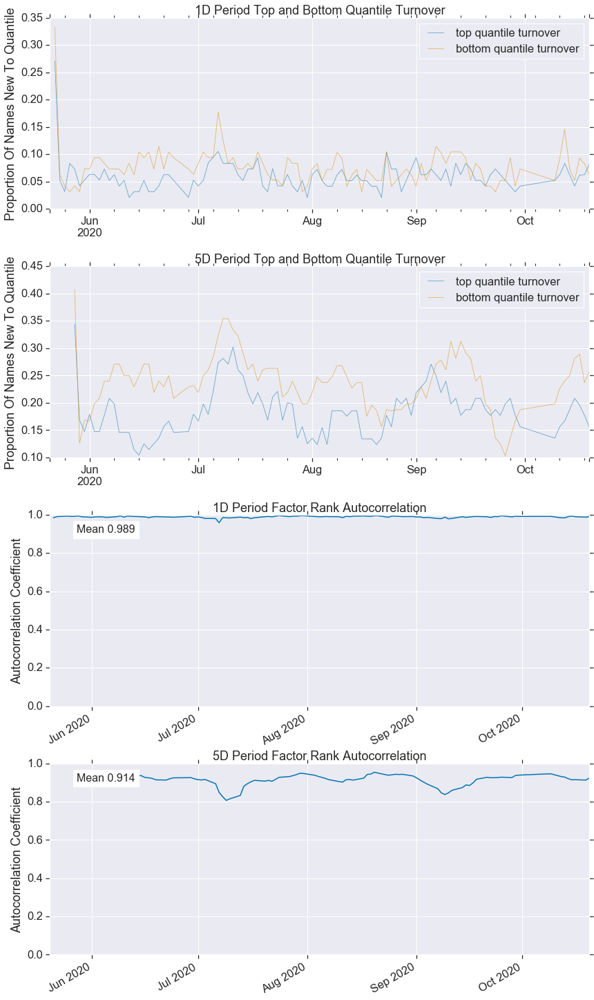

Momentum_1YR
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72847588,-1.02840740,-1.38405367,0.20098816,9780,20.08419756
2,-1.03995747,-0.33558557,-0.68977484,0.19980380,9715,19.95071363
3,-0.35873097,0.35575394,0.00099336,0.19932874,9718,19.95687442
4,0.32249552,1.03995747,0.69114269,0.19947648,9715,19.95071363
5,1.01821620,1.72847588,1.38468463,0.20068030,9767,20.05750077


Returns Analysis


,1D,5D
Ann. alpha,-0.15200000,-0.19100000
beta,0.10800000,0.14000000
Mean Period Wise Return Top Quantile (bps),-10.46200000,-12.12100000
Mean Period Wise Return Bottom Quantile (bps),1.77200000,1.57200000
Mean Period Wise Spread (bps),-12.24800000,-13.82600000


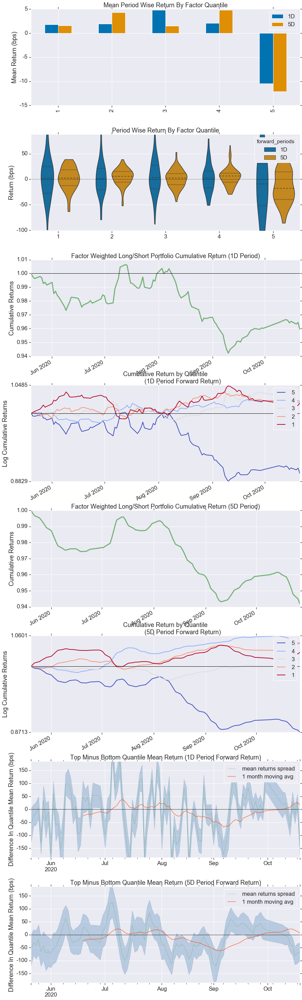

Information Analysis


,1D,5D
IC Mean,-0.01600000,-0.04200000
IC Std.,0.10100000,0.12500000
Risk-Adjusted IC,-0.15400000,-0.33400000
t-stat(IC),-1.55200000,-3.36900000
p-value(IC),0.12400000,0.00100000
IC Skew,-0.19300000,0.05100000
IC Kurtosis,-0.09100000,-0.76100000


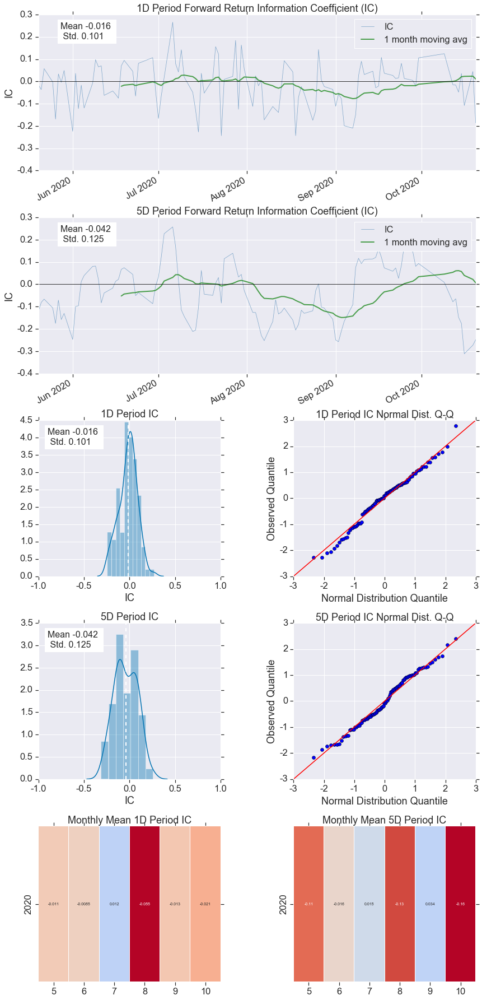

Turnover Analysis


,1D,5D
Quantile 1 Mean Turnover,0.05400000,0.12200000
Quantile 2 Mean Turnover,0.12400000,0.26700000
Quantile 3 Mean Turnover,0.14500000,0.29200000
Quantile 4 Mean Turnover,0.12300000,0.26800000
Quantile 5 Mean Turnover,0.05400000,0.12200000


,1D,5D
Mean Factor Rank Autocorrelation,0.99300000,0.96800000


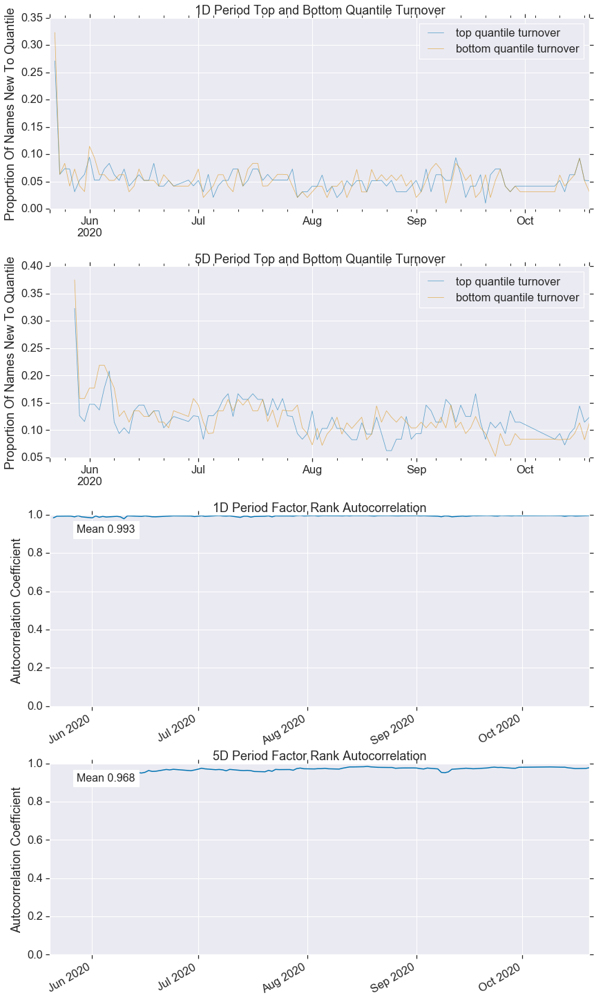

adv_20d                                  -0.03895444
adv_120d                                 -0.02955700
Mean_Reversion_Sector_Neutral_Smoothed    0.00445844
Overnight_Sentiment_Smoothed              0.01608205
volatility_20d                           -0.03001079
增强_ALPHA                                  0.04711568
Momentum_1YR                             -0.01553548
dtype: float64


In [12]:
factor_IC = show_sample_results(all_factors, X_test, clf_nov, factor_names)

So, hopefully you are appropriately amazed by this. Despite the significant differences between the factor performances in the three sets, the AI APLHA is able to deliver positive performance.